#### EDA - Exploratory Data Analysis.
##### Hourly energy demand generation and weather
###### Electrical demand, generation by type, prices and weather in Spain


En el ejercicio exploratorio se analizará la información obtenida en la plataforma [kaggel](https://www.kaggle.com/nicholasjhana/energy-consumption-generation-prices-and-weather?select=weather_features.csv) sobre un conjunto de datos que abarcan 4 años (Enero2015 a Diciembre2018) en España en intervalos de 1h., a través de dos ficheros:

Documento en formato 'energy_dataset.csv' con un peso de 28,8MB. Através de una de las [fuentes](https://transparency.entsoe.eu/dashboard/show) de origen se facilita los datos sobre la generación energética, previsión y demanda ,y el precio se recoge de [Red Electric España](https://www.esios.ree.es/es?locale=en). 

Archivo también en formato 'weather_features.csv' (18,9 MB), recoge [información climatológica](https://openweathermap.org/api) de las 5 ciudades más importantes del país. Los parámetros del clima definidos en el dataset se pueden consultar en [aquí](https://openweathermap.org/history-bulk#data), pagína informativa de la API.

Se empieza importando los módulos necesarios.

In [1]:
# import necesary packages
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
import seaborn as sns

from datetime import datetime
import calendar
import os

#interactive display modules
import plotly
from plotly.offline import init_notebook_mode, iplot, plot
import plotly.graph_objs as go

import functions_EDA as f_eda

Se definen los parametros para la visualización de los gráfico

In [2]:
# set style the visualization
plt.style.use('fivethirtyeight')
# ensure display of graphs in jupyter
%matplotlib inline
plotly.offline.init_notebook_mode()

Se crea las carpetas y variable para para almacenar las gráficas del EDA.

In [3]:
graphics = 'graphics/'
graphics_e = 'graphics/energy/'
graphics_w = 'graphics/weather/'

extension = '.png'

In [4]:
    savelocation_e =os.getcwd() +'/'+graphics_e
    savelocation_w = os.getcwd() + '/' + graphics_w
    
    #print(savelocation)
    # Creates new directory if the directory does not exist. Otherwise, just use the existing path.
    if not os.path.isdir(savelocation_e):
        os.mkdir(savelocation_e)
            
    if not os.path.isdir(savelocation_w):
        os.mkdir(savelocation_w)


#### ENERGY

In [5]:
# load first datasets
energy = pd.read_csv('energy_dataset.csv')

In [6]:
energy.head(3)

,time,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
0,2015-01-01 00:00:00+01:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,...,196.0,0.0,6378.0,17.0,NaN,6436.0,26118.0,25385.0,50.10,65.41
1,2015-01-01 01:00:00+01:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,...,195.0,0.0,5890.0,16.0,NaN,5856.0,24934.0,24382.0,48.10,64.92
2,2015-01-01 02:00:00+01:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,...,196.0,0.0,5461.0,8.0,NaN,5454.0,23515.0,22734.0,47.33,64.48


In [7]:
energy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35064 entries, 0 to 35063
Data columns (total 29 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   time                                         35064 non-null  object 
 1   generation biomass                           35045 non-null  float64
 2   generation fossil brown coal/lignite         35046 non-null  float64
 3   generation fossil coal-derived gas           35046 non-null  float64
 4   generation fossil gas                        35046 non-null  float64
 5   generation fossil hard coal                  35046 non-null  float64
 6   generation fossil oil                        35045 non-null  float64
 7   generation fossil oil shale                  35046 non-null  float64
 8   generation fossil peat                       35046 non-null  float64
 9   generation geothermal                        35046 non-null  float64
 10

Se quiere utilizar como indice la columna temporal. Se cambia el tipo de dato 'object' de la columna 'time' a 'datetime64' conservando 'timezone'

In [8]:
energy['time'] = energy['time'].apply(lambda x: np.datetime64(x, utc=True))
energy.set_index('time', drop=True, inplace=True)

C:\Users\pilar\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning:

parsing timezone aware datetimes is deprecated; this will raise an error in the future



In [9]:
energy.index.is_unique

True

In [10]:
#Check changes
energy.tail(2)

,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,...,generation waste,generation wind offshore,generation wind onshore,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,,,,,,,,,,
2018-12-31 21:00:00,293.0,0.0,0.0,6562.0,2293.0,163.0,0.0,0.0,0.0,NaN,...,287.0,0.0,3586.0,29.0,NaN,3273.0,25450.0,25801.0,63.93,69.89
2018-12-31 22:00:00,290.0,0.0,0.0,6926.0,2166.0,163.0,0.0,0.0,0.0,NaN,...,287.0,0.0,3651.0,26.0,NaN,3117.0,24424.0,24455.0,64.27,69.88


In [11]:
# show and observe columns
energy.columns

Index(['generation biomass', 'generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat',
       'generation geothermal', 'generation hydro pumped storage aggregated',
       'generation hydro pumped storage consumption',
       'generation hydro run-of-river and poundage',
       'generation hydro water reservoir', 'generation marine',
       'generation nuclear', 'generation other', 'generation other renewable',
       'generation solar', 'generation waste', 'generation wind offshore',
       'generation wind onshore', 'forecast solar day ahead',
       'forecast wind offshore eday ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'total load actual', 'price day ahead',
       'price actual'],
      dtype='object')

Se puede observar que existen tres bloques de información; el mayor número de columnas muestra la generación eléctrica en función de la fuentes , el segundo sobre estimaciones de generación solar, eólico y demanda energética, y el ultimo sobre precio estimación diaria y precio de cierre.

In [12]:
# Generation columns
energy.iloc[:5,:21]

,generation biomass,generation fossil brown coal/lignite,generation fossil coal-derived gas,generation fossil gas,generation fossil hard coal,generation fossil oil,generation fossil oil shale,generation fossil peat,generation geothermal,generation hydro pumped storage aggregated,...,generation hydro run-of-river and poundage,generation hydro water reservoir,generation marine,generation nuclear,generation other,generation other renewable,generation solar,generation waste,generation wind offshore,generation wind onshore
time,,,,,,,,,,,,,,,,,,,,,
2014-12-31 23:00:00,447.0,329.0,0.0,4844.0,4821.0,162.0,0.0,0.0,0.0,NaN,...,1051.0,1899.0,0.0,7096.0,43.0,73.0,49.0,196.0,0.0,6378.0
2015-01-01 00:00:00,449.0,328.0,0.0,5196.0,4755.0,158.0,0.0,0.0,0.0,NaN,...,1009.0,1658.0,0.0,7096.0,43.0,71.0,50.0,195.0,0.0,5890.0
2015-01-01 01:00:00,448.0,323.0,0.0,4857.0,4581.0,157.0,0.0,0.0,0.0,NaN,...,973.0,1371.0,0.0,7099.0,43.0,73.0,50.0,196.0,0.0,5461.0
2015-01-01 02:00:00,438.0,254.0,0.0,4314.0,4131.0,160.0,0.0,0.0,0.0,NaN,...,949.0,779.0,0.0,7098.0,43.0,75.0,50.0,191.0,0.0,5238.0
2015-01-01 03:00:00,428.0,187.0,0.0,4130.0,3840.0,156.0,0.0,0.0,0.0,NaN,...,953.0,720.0,0.0,7097.0,43.0,74.0,42.0,189.0,0.0,4935.0


In [13]:
# Forecast columns
energy[['forecast solar day ahead',
       'forecast wind offshore eday ahead', 'forecast wind onshore day ahead',
       'total load forecast', 'total load actual']][:5]

,forecast solar day ahead,forecast wind offshore eday ahead,forecast wind onshore day ahead,total load forecast,total load actual
time,,,,,
2014-12-31 23:00:00,17.0,NaN,6436.0,26118.0,25385.0
2015-01-01 00:00:00,16.0,NaN,5856.0,24934.0,24382.0
2015-01-01 01:00:00,8.0,NaN,5454.0,23515.0,22734.0
2015-01-01 02:00:00,2.0,NaN,5151.0,22642.0,21286.0
2015-01-01 03:00:00,9.0,NaN,4861.0,21785.0,20264.0


In [14]:
#Price columns
energy[['price day ahead','price actual']][:5]

,price day ahead,price actual
time,,
2014-12-31 23:00:00,50.10,65.41
2015-01-01 00:00:00,48.10,64.92
2015-01-01 01:00:00,47.33,64.48
2015-01-01 02:00:00,42.27,59.32
2015-01-01 03:00:00,38.41,56.04


Inicialmente, se revisa la naturaleza de los datos de las columnas, la cantidad de Nan/null o datos a '0'.

In [15]:
#check how many total rows and columns we have and how many of those are missing or zero values.
print(('NUMBER NULL/NAN_VALUES OF COLUMNS DATAFRAME:\n'))
energy.isnull().sum()

NUMBER NULL/NAN_VALUES OF COLUMNS DATAFRAME:



generation biomass                                19
generation fossil brown coal/lignite              18
generation fossil coal-derived gas                18
generation fossil gas                             18
generation fossil hard coal                       18
generation fossil oil                             19
generation fossil oil shale                       18
generation fossil peat                            18
generation geothermal                             18
generation hydro pumped storage aggregated     35064
generation hydro pumped storage consumption       19
generation hydro run-of-river and poundage        19
generation hydro water reservoir                  18
generation marine                                 19
generation nuclear                                17
generation other                                  18
generation other renewable                        18
generation solar                                  18
generation waste                              

In [16]:
f_eda.percentage_nan_columns(energy)

PERCENTAGE NAN_VALUES OF COLUMNS DATAFRAME:

0.- generation biomass : 0.0542 %

1.- generation fossil brown coal/lignite : 0.0513 %

2.- generation fossil coal-derived gas : 0.0513 %

3.- generation fossil gas : 0.0513 %

4.- generation fossil hard coal : 0.0513 %

5.- generation fossil oil : 0.0542 %

6.- generation fossil oil shale : 0.0513 %

7.- generation fossil peat : 0.0513 %

8.- generation geothermal : 0.0513 %

9.- generation hydro pumped storage aggregated : 100.0 %

10.- generation hydro pumped storage consumption : 0.0542 %

11.- generation hydro run-of-river and poundage : 0.0542 %

12.- generation hydro water reservoir : 0.0513 %

13.- generation marine : 0.0542 %

14.- generation nuclear : 0.0485 %

15.- generation other : 0.0513 %

16.- generation other renewable : 0.0513 %

17.- generation solar : 0.0513 %

18.- generation waste : 0.0542 %

19.- generation wind offshore : 0.0513 %

20.- generation wind onshore : 0.0513 %

21.- forecast solar day ahead : 0.0 %

22.- fo

In [17]:
f_eda.percentage_zeros_columns(energy)

PERCENTAGE ZERO_VALUES OF COLUMNS DATAFRAME:

0.- generation biomass : 0.011 %

1.- generation fossil brown coal/lignite : 29.994 %

2.- generation fossil coal-derived gas : 99.949 %

3.- generation fossil gas : 0.003 %

4.- generation fossil hard coal : 0.009 %

5.- generation fossil oil : 0.009 %

6.- generation fossil oil shale : 99.949 %

7.- generation fossil peat : 99.949 %

8.- generation geothermal : 99.949 %

9.- generation hydro pumped storage aggregated : 0.0 %

10.- generation hydro pumped storage consumption : 35.954 %

11.- generation hydro run-of-river and poundage : 0.009 %

12.- generation hydro water reservoir : 0.009 %

13.- generation marine : 99.946 %

14.- generation nuclear : 0.009 %

15.- generation other : 0.011 %

16.- generation other renewable : 0.009 %

17.- generation solar : 0.009 %

18.- generation waste : 0.009 %

19.- generation wind offshore : 99.949 %

20.- generation wind onshore : 0.009 %

21.- forecast solar day ahead : 1.537 %

22.- forecast wind

Existen dos series del dataFrame 'energy' que no registra ningún tipo de dato (missing_values), son:

9.- generation hydro pumped storage aggregated

22.- forecast wind offshore eday ahead

En el resto de columnas los valores 'NaN' representan entre 0,1% y 0,05%, de 18 a 36 filas de 35064 registros.

Existen 6 columnas que tienen practicamente los valores de sus registros a '0'. Esto podría significar que no existe generación electrica con esas fuentes de origen en España o que es residual.

Soy las columnas:

2.- generation fossil coal-derived gas

6.- generation fossil oil shale 

7.- generation fossil peat

8.- generation geothermal

13.- generation marine

19.- generation wind offshore


Como se quiere analizar la influencia de los fenómenos atmosfericos y el clima contemplados en el dataset 'weather' a la generación, a la demanda y su efecto en el precio, se simplifica el dataFrame a las fuentes principales de generación.

Se agrupa la generación electrica por; fosil, hidráulica, nuclear, solar, eólica y en otras, tanto las renovables como las no renovables, ya que su peso en el computo de generación no es relevante, y también porque el objetivo pricipal de negocio son el estudio de las fuentes; 'solar', 'eólica' e 'hídirca'.

De esta forma también se elimina gran parte de los missing_values y de los valores a '0' que hay.

A la columna que recoge la generación fosil se le suma todos los MegaWatios de; 'generation fossil brown coal/lignite', 'generation fossil coal-derived gas', 'generation fossil gas', 'generation fossil hard coal', 'generation fossil oil', 'generation fossil oil shale' y 'generation fossil peat'. Se coloca en 1a posición del indice. Y se eliminan las columnas que la contienen.

In [18]:
fossil_col= energy[['generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat']].sum(axis=1)

energy.insert(loc=0, column='generation fossil', value=fossil_col)
energy.drop(columns= ['generation fossil brown coal/lignite',
       'generation fossil coal-derived gas', 'generation fossil gas',
       'generation fossil hard coal', 'generation fossil oil',
       'generation fossil oil shale', 'generation fossil peat'], inplace=True)

Se realiza lo mismo con las fuentes de energía generadas con agua (hídircas).

In [19]:
hydro_col= energy[['generation hydro pumped storage aggregated','generation hydro pumped storage consumption','generation hydro run-of-river and poundage','generation hydro water reservoir']].sum(axis=1)

energy.insert(loc=1, column='generation hydro', value=hydro_col)

energy.drop(columns= ['generation hydro pumped storage aggregated','generation hydro pumped storage consumption','generation hydro run-of-river and poundage','generation hydro water reservoir'], inplace=True)


Se suma a la columna de 'generation other renewable', los valores de las series; 'generation biomass', 'generation geothermal', 'generation marine' y 'generation waste'. Y ésta se unifica a 'generation other'.

También se realizará la agrupación de las columnas de 'wind', tanto en generación como en previsión.

In [20]:
energy['generation other'] = energy[['generation other','generation other renewable','generation biomass','generation geothermal', 'generation marine','generation waste']].sum(axis=1)

energy.drop(columns= ['generation biomass','generation geothermal', 'generation marine','generation waste', 'generation other renewable'], inplace=True)


In [21]:
wind_col = energy[['generation wind onshore', 'generation wind offshore']].sum(axis=1)

energy.insert(loc=5, column='generation wind', value=wind_col) 

energy.drop(columns= ['generation wind onshore', 'generation wind offshore'], inplace=True)

In [22]:
wind_forecast = energy[['forecast wind offshore eday ahead', 'forecast wind onshore day ahead']].sum(axis=1)

energy.insert(loc=7, column='forecast wind eday ahead', value=wind_forecast) 

energy.drop(columns= ['forecast wind offshore eday ahead', 'forecast wind onshore day ahead'], inplace=True)

In [23]:
energy.head()

,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,forecast solar day ahead,forecast wind eday ahead,total load forecast,total load actual,price day ahead,price actual
time,,,,,,,,,,,,
2014-12-31 23:00:00,10156.0,3813.0,7096.0,759.0,49.0,6378.0,17.0,6436.0,26118.0,25385.0,50.10,65.41
2015-01-01 00:00:00,10437.0,3587.0,7096.0,758.0,50.0,5890.0,16.0,5856.0,24934.0,24382.0,48.10,64.92
2015-01-01 01:00:00,9918.0,3508.0,7099.0,760.0,50.0,5461.0,8.0,5454.0,23515.0,22734.0,47.33,64.48
2015-01-01 02:00:00,8859.0,3231.0,7098.0,747.0,50.0,5238.0,2.0,5151.0,22642.0,21286.0,42.27,59.32
2015-01-01 03:00:00,8313.0,3499.0,7097.0,734.0,42.0,4935.0,9.0,4861.0,21785.0,20264.0,38.41,56.04


In [24]:
energy.index.is_unique

True

In [25]:
energy.shape

(35064, 12)

In [26]:
energy.describe().T

,count,mean,std,min,25%,50%,75%,max
generation fossil,35064.0,10619.719313,3946.767547,0.00,7398.7500,10415.00,13294.25,28085.00
generation hydro,35064.0,4050.686402,2115.462454,0.00,2391.0000,3587.00,5313.00,11613.00
generation nuclear,35047.0,6263.907039,839.667958,0.00,5760.0000,6566.00,7025.00,7117.00
generation other,35064.0,798.405259,92.672170,0.00,749.0000,804.00,854.00,1063.00
generation solar,35046.0,1432.665925,1680.119887,0.00,71.0000,616.00,2578.00,5792.00
generation wind,35064.0,5461.674595,3215.250084,0.00,2930.7500,4847.00,7397.00,17436.00
forecast solar day ahead,35064.0,1439.066735,1677.703355,0.00,69.0000,576.00,2636.00,5836.00
forecast wind eday ahead,35064.0,5471.216689,3176.312853,237.00,2979.0000,4855.00,7353.00,17430.00
total load forecast,35064.0,28712.129962,4594.100854,18105.00,24793.7500,28906.00,32263.25,41390.00
total load actual,35028.0,28696.939905,4574.987950,18041.00,24807.7500,28901.00,32192.00,41015.00


Una vez se han agrupado las columnas indicadas en este dataset, se vuelve a verificar las que tienen datos tipo 'NaN', y cuantos resgistros en cada serie.

Para conocer que tratamiento se le aplicará más adelanrte.

In [27]:
energy.isnull().any()

generation fossil           False
generation hydro            False
generation nuclear           True
generation other            False
generation solar             True
generation wind             False
forecast solar day ahead    False
forecast wind eday ahead    False
total load forecast         False
total load actual            True
price day ahead             False
price actual                False
dtype: bool

In [28]:
#Check columns with Nan values and number
print(('NUMBER NULL/NAN_VALUES OF COLUMNS DATAFRAME:\n'))
energy.isnull().sum()

NUMBER NULL/NAN_VALUES OF COLUMNS DATAFRAME:



generation fossil            0
generation hydro             0
generation nuclear          17
generation other             0
generation solar            18
generation wind              0
forecast solar day ahead     0
forecast wind eday ahead     0
total load forecast          0
total load actual           36
price day ahead              0
price actual                 0
dtype: int64

In [29]:
print('Total Nan_values:',energy.isnull().sum().sum())

Total Nan_values: 71


In [30]:
#Check columns with '0' zero values 
f_eda.percentage_nan_columns(energy)

PERCENTAGE NAN_VALUES OF COLUMNS DATAFRAME:

0.- generation fossil : 0.0 %

1.- generation hydro : 0.0 %

2.- generation nuclear : 0.0485 %

3.- generation other : 0.0 %

4.- generation solar : 0.0513 %

5.- generation wind : 0.0 %

6.- forecast solar day ahead : 0.0 %

7.- forecast wind eday ahead : 0.0 %

8.- total load forecast : 0.0 %

9.- total load actual : 0.1027 %

10.- price day ahead : 0.0 %

11.- price actual : 0.0 %



#### Histogramas y desidad de probabilidad 


Con la visualización gráfica de los histogramas de las variables del dataset 'energy', se inicia el estudio de las funciones de densidad de probabilidad del conjunto de datos, así como intuir la naturaleza de las muestras en cada una de los atriburtos. 

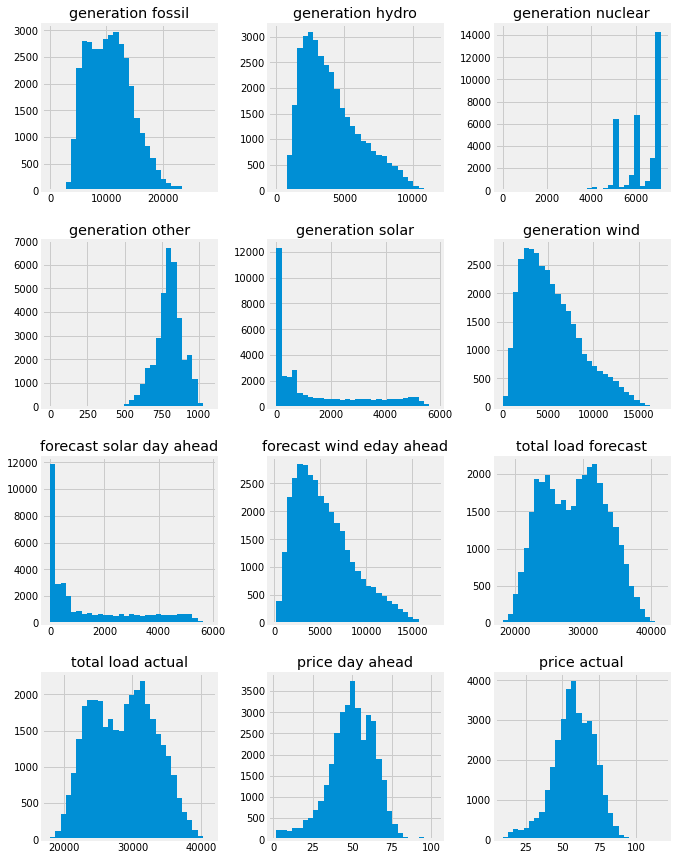

In [31]:
# histogram of attributes

energy.hist(figsize=(10,15), bins=30);
plt.savefig(graphics_e +'energy_hist'+extension)

El siguiente paso natural es estudiar desde los histogramas hacia las funciones de densidad de probabilidad, y cómo se distribuyen los datos.

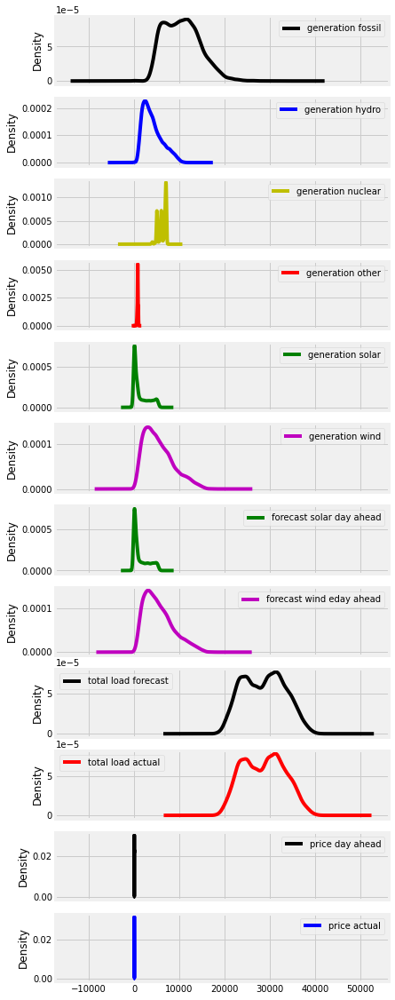

In [32]:
#KDE generation and forecast variables
energy.plot(kind = 'kde', subplots=True, figsize=(6,20), color=['k','b','y','r','g','m','g','m','k','r'])
plt.savefig(graphics_e +'energy_kde'+extension);

Para identificar mejor los valores anómalos o 'outlayer', una de las mejores herramienta de visualización que se dispone es el diagrama de cajas, y así, tener en cuenta como se filtrarán estos datos en cada atributo.

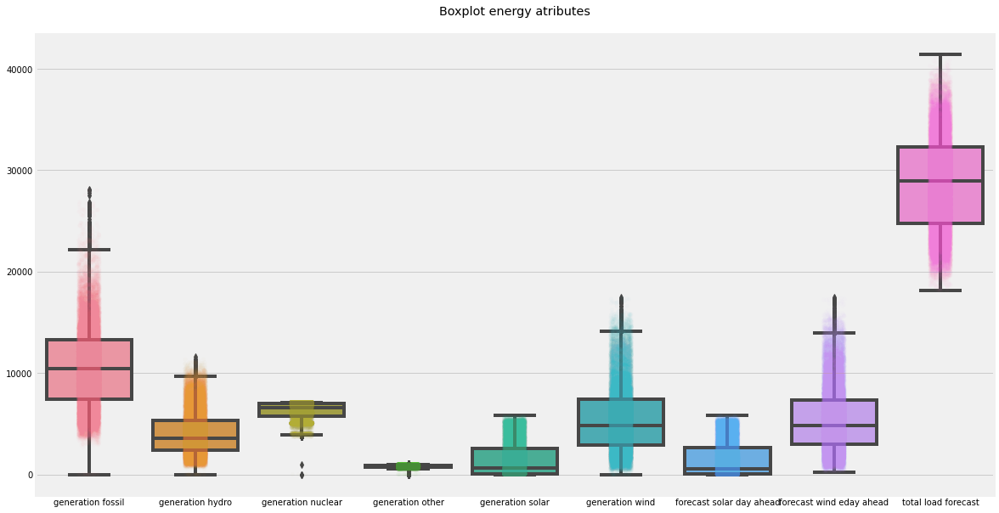

In [33]:
plt.subplots(figsize=(18,10))
sns.boxplot(data=energy.iloc[:,:9] )
sns.stripplot(data=energy.iloc[:,:9], alpha=0.02)
plt.title('Boxplot energy atributes\n')
plt.savefig(graphics_e +'generation_energy_boxplot'+extension);

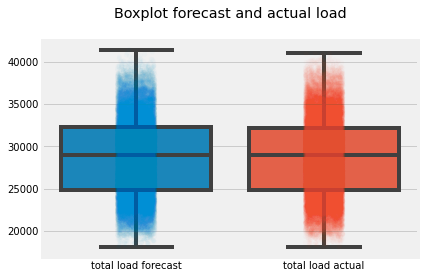

In [34]:
sns.boxplot(data=energy.iloc[:,8:-2])
sns.stripplot(data=energy.iloc[:,8:-2], alpha=0.02, );
plt.title('Boxplot forecast and actual load\n')
plt.savefig(graphics_e +'load_energy_boxplot'+extension);

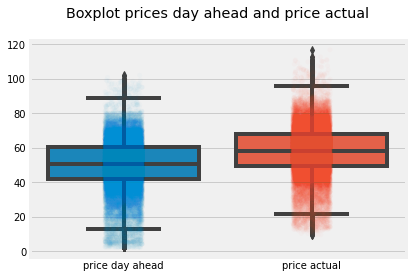

In [35]:
sns.boxplot(data=energy[['price day ahead','price actual']])
sns.stripplot(data=energy[['price day ahead','price actual']], alpha=0.02)
plt.title('Boxplot prices day ahead and price actual\n')
plt.savefig(graphics_e +'price_energy_boxplot'+extension);

#### Tratamiento de outlayers

Se crea una función especifica para filtrar los valores anómalos de cada serie.

Esta función está dentro de un módulo propio 'functions_EDA.py' que se ha importado junto con el resto de paquetes, para optimizar su uso en los dataset que se trabajen en otro projectos de exploración

In [31]:
# columns are traversed and outlayer_drop function is executed
for i in energy.columns:
    print(i.upper())
    
    #function drop_outlayer
    energy = f_eda.drop_outlayers_df(energy, i)
    #energy = drop_outlayers_df(energy,i)
    print('Delete', i,'outlayers, length dataframe is ',energy.shape[0])
    print('\n')

GENERATION FOSSIL
Delete generation fossil outlayers, length dataframe is  34891


GENERATION HYDRO
Delete generation hydro outlayers, length dataframe is  34582


GENERATION NUCLEAR
Delete generation nuclear outlayers, length dataframe is  34462


GENERATION OTHER
Delete generation other outlayers, length dataframe is  33723


GENERATION SOLAR
Delete generation solar outlayers, length dataframe is  33723


GENERATION WIND
Delete generation wind outlayers, length dataframe is  33330


FORECAST SOLAR DAY AHEAD
Delete forecast solar day ahead outlayers, length dataframe is  33330


FORECAST WIND EDAY AHEAD
Delete forecast wind eday ahead outlayers, length dataframe is  33156


TOTAL LOAD FORECAST
Delete total load forecast outlayers, length dataframe is  33156


TOTAL LOAD ACTUAL
Delete total load actual outlayers, length dataframe is  33156


PRICE DAY AHEAD
Delete price day ahead outlayers, length dataframe is  32562


PRICE ACTUAL
Delete price actual outlayers, length dataframe is  32

Una vez manejados los valores anómalos, volvemos a representar histogramas, kde y diagrama de cajas.

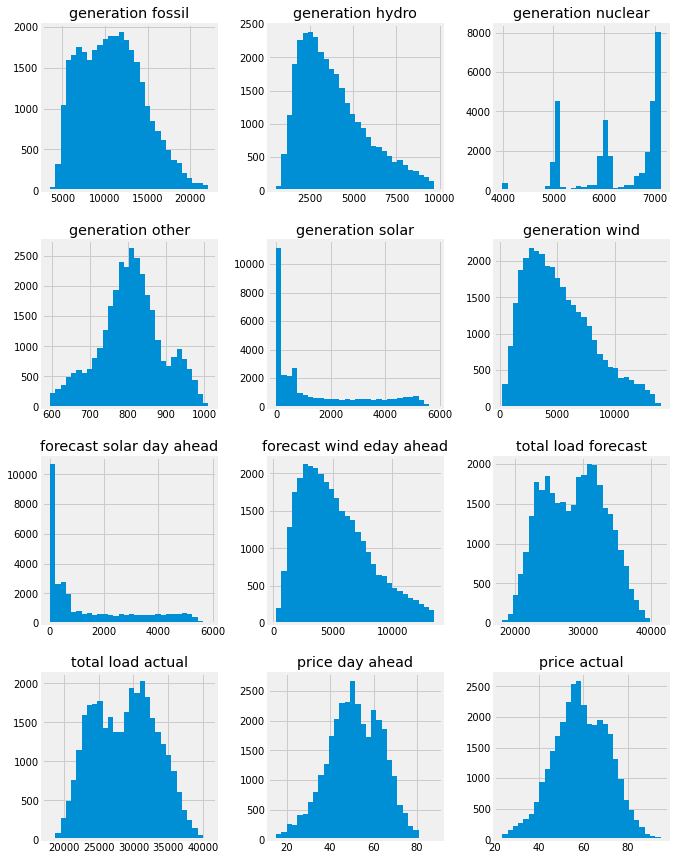

In [32]:
# histogram of attributes
energy.hist(figsize=(10,15), bins=30)
plt.savefig(graphics_e +'without_outlayers/'+'energy_hist'+extension);

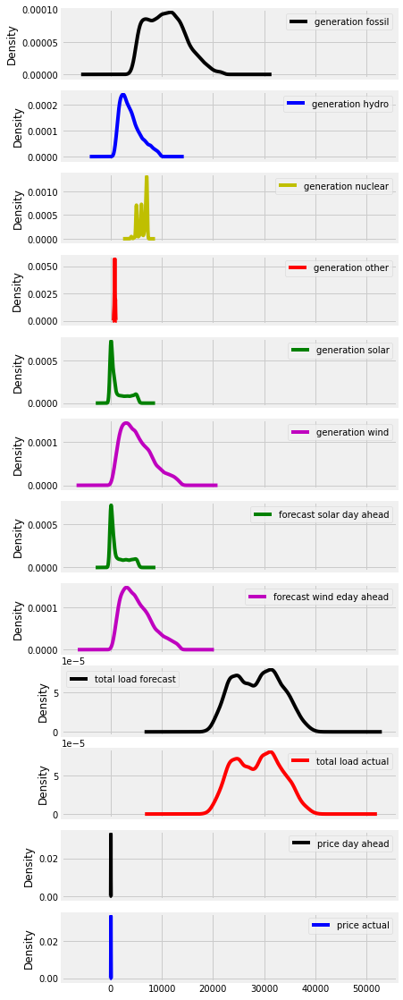

In [38]:
#KDE generation and forecast variables
energy.plot(kind = 'kde', subplots=True, figsize=(6,20), color=['k','b','y','r','g','m','g','m','k','r'])
plt.savefig(graphics_e +'without_outlayers/'+'energy_kde'+extension);

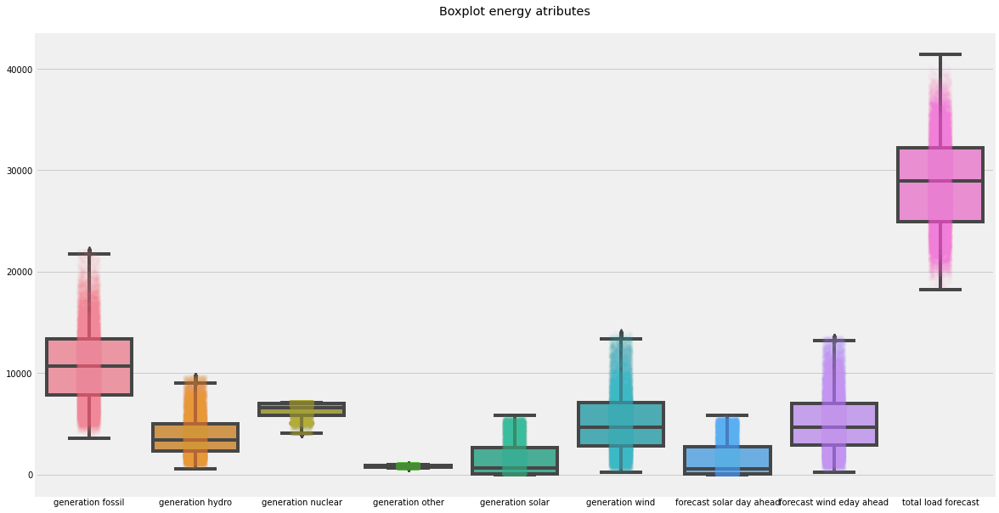

In [39]:
plt.subplots(figsize=(18,10))
sns.boxplot(data=energy.iloc[:,:9] )
sns.stripplot(data=energy.iloc[:,:9], alpha=0.02)
plt.title('Boxplot energy atributes\n')
plt.savefig(graphics_e +'generation_energy_boxplot'+extension);

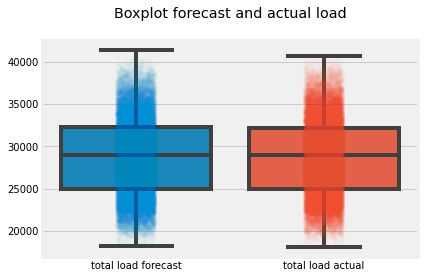

In [40]:
sns.boxplot(data=energy.iloc[:,8:-2])
sns.stripplot(data=energy.iloc[:,8:-2], alpha=0.02, );
plt.title('Boxplot forecast and actual load\n')
plt.savefig(graphics_e +'without_outlayers/'+'load_energy_boxplot'+extension);

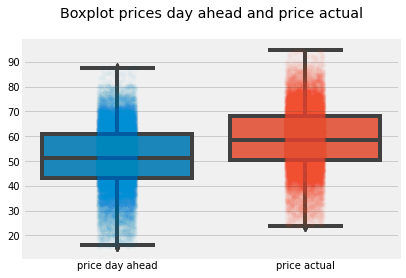

In [41]:
sns.boxplot(data=energy[['price day ahead','price actual']])
sns.stripplot(data=energy[['price day ahead','price actual']], alpha=0.02)
plt.title('Boxplot prices day ahead and price actual\n')
plt.savefig(graphics_e+'without_outlayers/' +'price_energy_boxplot'+extension);

#### Visualización gráfica histogramas y scatterplot entre atributos

Se visualizará las correlaciones lineales de dos en dos.

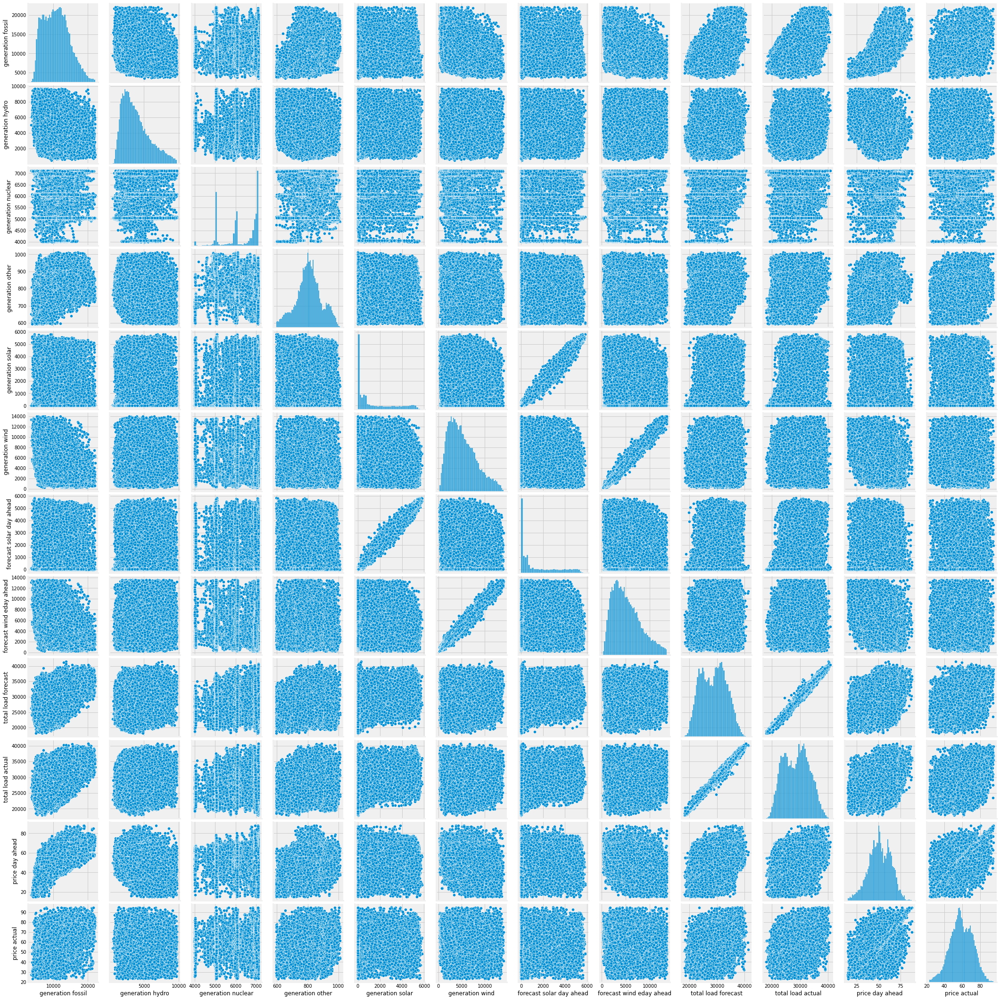

In [61]:
sns.pairplot(energy);
plt.savefig(graphics_e +'energy_pairplot'+extension);

Aparte de las relaciones directas y lógicas que existen entre generación y estimacion solar y eólica, así como en demanda y precio. Se puede obsevar que la generación fósil es la que tiene visulmente una correlación más evidente con la variable demanda y precio.

##### Correlación

En este punto se van a medir las relaciones lineas que existen entre los diferentes atributos.

In [33]:
energy.corr()

,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,forecast solar day ahead,forecast wind eday ahead,total load forecast,total load actual,price day ahead,price actual
generation fossil,1.000000,-0.244400,-0.086804,0.350442,0.068048,-0.437581,0.072746,-0.437427,0.529363,0.535199,0.709766,0.483992
generation hydro,-0.244400,1.000000,-0.057400,-0.210249,0.030676,0.101982,0.039098,0.108420,0.284602,0.284790,-0.176602,-0.032006
generation nuclear,-0.086804,-0.057400,1.000000,0.011488,0.003229,0.068348,-0.000327,0.067143,0.096040,0.090430,-0.076956,-0.072682
generation other,0.350442,-0.210249,0.011488,1.000000,-0.013783,-0.125528,-0.017173,-0.128077,0.129256,0.127269,0.259072,0.217212
generation solar,0.068048,0.030676,0.003229,-0.013783,1.000000,-0.166391,0.993434,-0.172628,0.416751,0.414943,0.047959,0.109201
generation wind,-0.437581,0.101982,0.068348,-0.125528,-0.166391,1.000000,-0.171020,0.994028,0.065512,0.063626,-0.345219,-0.170474
forecast solar day ahead,0.072746,0.039098,-0.000327,-0.017173,0.993434,-0.171020,1.000000,-0.176793,0.424272,0.423323,0.053586,0.112777
forecast wind eday ahead,-0.437427,0.108420,0.067143,-0.128077,-0.172628,0.994028,-0.176793,1.000000,0.064600,0.062897,-0.345270,-0.169225
total load forecast,0.529363,0.284602,0.096040,0.129256,0.416751,0.065512,0.424272,0.064600,1.000000,0.995366,0.460051,0.417587
total load actual,0.535199,0.284790,0.090430,0.127269,0.414943,0.063626,0.423323,0.062897,0.995366,1.000000,0.462056,0.418124


Se realiza seleción de aquellos valores que se encuentre por encima de 0,4 y por debajo de -0,4, al no llegar a apreciarse relaciones lineales muy fuertes entre los difrentes atributos del dataset. 

In [34]:
energy.corr()[(energy.corr() > 0.4) | (energy.corr() < -0.4)]

,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,forecast solar day ahead,forecast wind eday ahead,total load forecast,total load actual,price day ahead,price actual
generation fossil,1.000000,NaN,NaN,NaN,NaN,-0.437581,NaN,-0.437427,0.529363,0.535199,0.709766,0.483992
generation hydro,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
generation nuclear,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
generation other,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
generation solar,NaN,NaN,NaN,NaN,1.000000,NaN,0.993434,NaN,0.416751,0.414943,NaN,NaN
generation wind,-0.437581,NaN,NaN,NaN,NaN,1.000000,NaN,0.994028,NaN,NaN,NaN,NaN
forecast solar day ahead,NaN,NaN,NaN,NaN,0.993434,NaN,1.000000,NaN,0.424272,0.423323,NaN,NaN
forecast wind eday ahead,-0.437427,NaN,NaN,NaN,NaN,0.994028,NaN,1.000000,NaN,NaN,NaN,NaN
total load forecast,0.529363,NaN,NaN,NaN,0.416751,NaN,0.424272,NaN,1.000000,0.995366,0.460051,0.417587
total load actual,0.535199,NaN,NaN,NaN,0.414943,NaN,0.423323,NaN,0.995366,1.000000,0.462056,0.418124


Se verifica numericamente que la generación fósil es la que tiene una correlación lineal más fuerte con la variable demanda y precio. Y una relación inversa con la generación eólica. 

Teneniendo en cuenta que el dato que se desea averiguar a futuro es el precio por mW/hora, se ordenan las correlaciones lineales que tiene con el resto de atributos.

In [35]:
energy.corr()['price actual'].abs().sort_values(ascending=False)

price actual                1.000000
price day ahead             0.720350
generation fossil           0.483992
total load actual           0.418124
total load forecast         0.417587
generation other            0.217212
generation wind             0.170474
forecast wind eday ahead    0.169225
forecast solar day ahead    0.112777
generation solar            0.109201
generation nuclear          0.072682
generation hydro            0.032006
Name: price actual, dtype: float64

Se ha podido comprobar con el gráfico 'pairplot' y, ahora con el valor numérico que existen varias columnas con correlaciones lineales practicamente iguales. 

Se eliminarán del dataset para evitar la multicolinialidad una de ambas de las columnas implicadas; total load forecast, forecast wind eday ahead y forecast solar day ahead, y en este caso se mantendrán los valores reales.

In [36]:
energy.drop(['total load forecast','forecast wind eday ahead','forecast solar day ahead'], axis=1, inplace=True)

Se elimina del dataset, la previsión (price day ahead) de precio por hora, ya que se dispone del precio final cerrado de consumo.

In [37]:
energy.drop(['price day ahead'], axis=1, inplace=True)

In [38]:
energy.head()

,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,total load actual,price actual
time,,,,,,,,
2014-12-31 23:00:00,10156.0,3813.0,7096.0,759.0,49.0,6378.0,25385.0,65.41
2015-01-01 00:00:00,10437.0,3587.0,7096.0,758.0,50.0,5890.0,24382.0,64.92
2015-01-01 01:00:00,9918.0,3508.0,7099.0,760.0,50.0,5461.0,22734.0,64.48
2015-01-01 02:00:00,8859.0,3231.0,7098.0,747.0,50.0,5238.0,21286.0,59.32
2015-01-01 03:00:00,8313.0,3499.0,7097.0,734.0,42.0,4935.0,20264.0,56.04


Una vez que el dataset se ha definido con las columna con las que se desea trabajar el modelo predictivo, se visualiza de nuevo el pairplot.

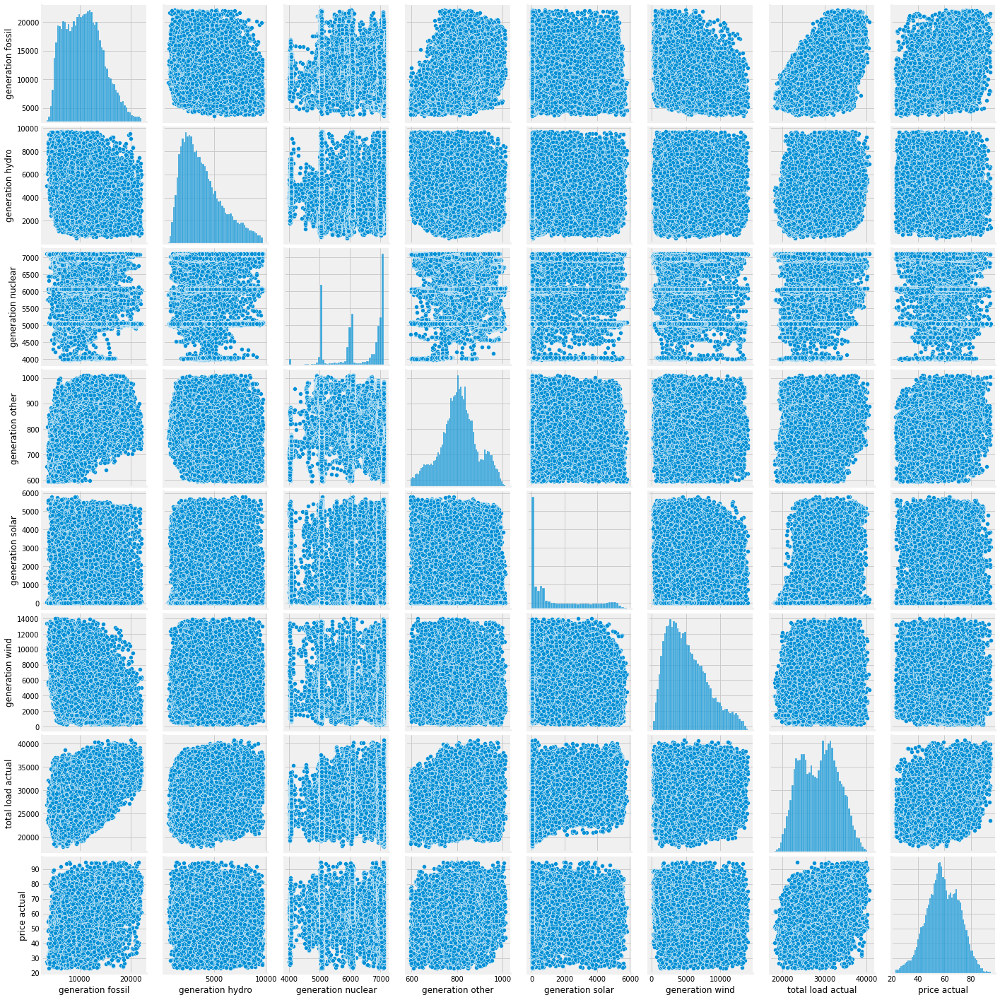

In [53]:
sns.pairplot(energy)
plt.savefig(graphics_e +'without_outlayers/'+'energy_pairplot'+extension);

#### Comportamiento de las fuentes de energía

En este punto se inicia la observación del comportamiento de los diferentes tipos de generación, y se utilizará gráfico de linea. 

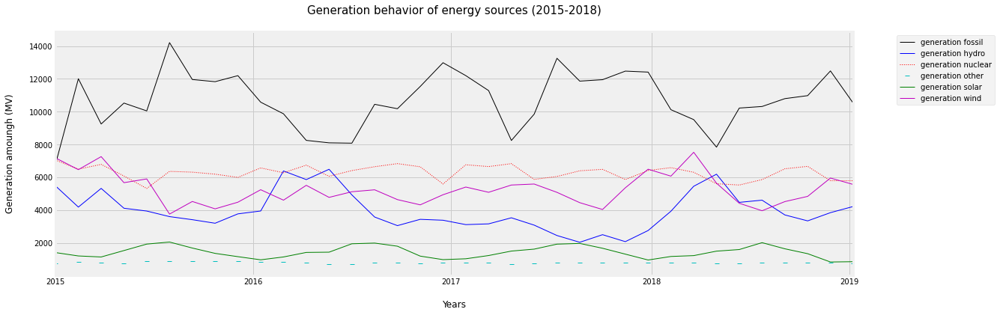

In [39]:
style = ['k-','b-','r:','c_','g-','m-']

energy.iloc[:,:6].resample('6W').mean().plot(style=style ,figsize=(17,6), linewidth=1)
lgd = plt.legend(bbox_to_anchor=(1.05, 1),loc= 'upper left')
plt.title('Generation behavior of energy sources (2015-2018)\n', fontsize=15)
plt.ylabel('Generation amoungh (MV)\n')
plt.xlabel('\nYears')
plt.savefig(graphics_e +'behavior_energy_generation_years'+extension,  bbox_inches='tight');

In [40]:
#Select all rows of year 2018, and get mean groupping monthly every column
energy_2018 = energy[energy.index.year == 2018]
generation_2018 = energy_2018.iloc[:,:6].resample('M').mean()
generation_2018

,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind
time,,,,,,
2018-01-31,10449.887918,3802.333333,6715.016012,807.705968,1087.790393,5910.868996
2018-02-28,10395.597561,4431.643293,6422.442073,825.826220,1275.931402,6710.167683
2018-03-31,7805.608772,6465.756140,6115.754386,779.945614,1408.435088,8091.124561
2018-04-30,7983.952452,6167.286776,5496.549777,743.062407,1512.362556,5139.646360
2018-05-31,10453.658247,4580.756315,5448.356612,737.364042,1483.692422,4095.473997
2018-06-30,9502.777622,4966.827972,5601.496503,800.492308,1846.125874,4773.500699
2018-07-31,10676.471063,4182.710633,6121.507402,825.880215,2010.341857,4044.753701
2018-08-31,10833.653226,3509.549731,6655.331989,819.970430,1706.931452,4363.241935
2018-09-30,11339.608333,3354.466667,6621.997222,821.072222,1510.647222,4272.663889


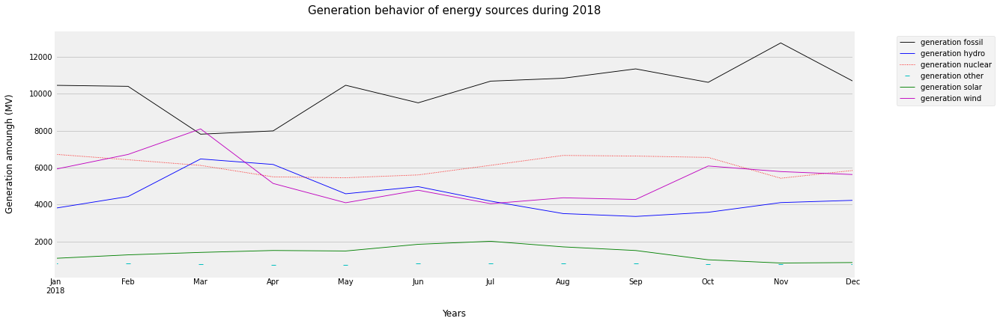

In [41]:
generation_2018.plot(style=style,figsize=(17,6), linewidth=0.9)
plt.legend(bbox_to_anchor=(1.05, 1),loc= 'upper left')
plt.title('Generation behavior of energy sources during 2018\n', fontsize=15)
plt.ylabel('Generation amoungh (MV)\n')
plt.xlabel('\nYears')
plt.savefig(graphics_e +'behavior_energy_generation_2018'+extension,  bbox_inches='tight');

Con ambas gráficas se puede ver que la generación hidroeléCtrica ,la eólica y la solar son claramente estacionales.

La energía obtenida a través del sol tiene un ligero aunmento de producción en los meses de verano y principios de otoño, y un descenso moderado en invierno.

La energía eólica tiene su pico de producción en primavera, importante cuota tanto en invierno como otoño, y un valle muy pronunciado en verano.

La época de mayor generación hídrica es en el periodo de primavera, se interpreta que es por ser la época de deshielo y lluvias. Podemos observar, por ejemplo, en la gráfica entre 2015 y 2018, que en el año 2017 no se obtuvo una importante producción en dicho periodo, por tanto pudo darse un invierno de sequía, sin muchas precipitaciones.

El comportamiento de la energía fosíl, parece que está fuertemente condicionado tanto a la eólica como a la hidroeléctrica, ya que su producción es inversa a la generación de estas. Esto denota que es una fuente programable y de rápida respuesta para cubrir la demanda.

Las 'otras' fuentes de energía y la nuclear, tiene un comportamiento muy estable dentro de la generación total.

Ahora se busca visualizar los pesos de los diferentes tipos de fuentes con un gráfico de barras acumulado, colocando en la base las más constantes y que tienen menos relación directa con el clima. Se utilizará las medias mensuales, y se pintará también linea de la demanda total media. Se elegirá el último año del que se dispone para visualizar la dimensión que respresenta cada origen de generación.

In [42]:
load_2018 = energy[energy.index.year == 2018]['total load actual'].resample('M').mean()
load_2018

time
2018-01-31    30025.685590
2018-02-28    30379.376524
2018-03-31    29740.126316
2018-04-30    27830.442793
2018-05-31    28246.800892
2018-06-30    29223.705882
2018-07-31    29600.760431
2018-08-31    29067.302419
2018-09-30    29166.197222
2018-10-31    28008.236735
2018-11-30    29561.616715
2018-12-31    28865.039437
Freq: M, Name: total load actual, dtype: float64

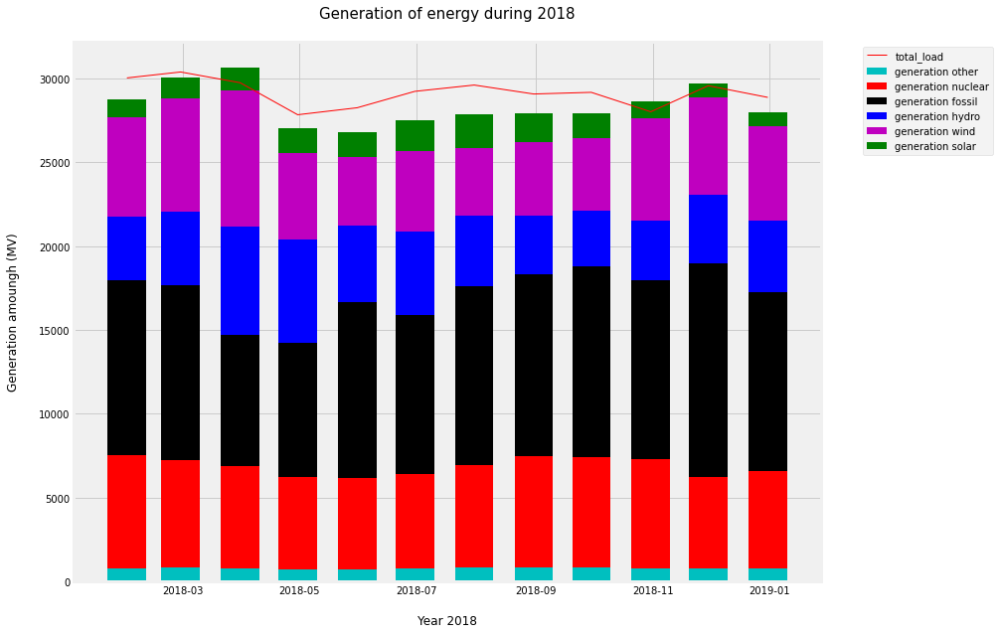

In [43]:
width = 20
plt.subplots(figsize=(12,10))

plt.bar(generation_2018.index, generation_2018.loc[:,'generation other'], width = width, label= 'generation other', color='c')

plt.bar(generation_2018.index, generation_2018.loc[:,'generation nuclear'], width = width, bottom= generation_2018.loc[:,'generation other'], label='generation nuclear', color='r')

plt.bar(generation_2018.index, generation_2018.loc[:,'generation fossil'], width = width, bottom= generation_2018.loc[:,'generation nuclear']+generation_2018.loc[:,'generation other'], label= 'generation fossil', color='k')

plt.bar(generation_2018.index, generation_2018.loc[:,'generation hydro'], width = width, bottom= generation_2018.loc[:,'generation fossil']+generation_2018.loc[:,'generation nuclear']+generation_2018.loc[:,'generation other'], label= 'generation hydro', color='b')

plt.bar(generation_2018.index, generation_2018.loc[:,'generation wind'], width = width, bottom= generation_2018.loc[:,'generation hydro'] + generation_2018.loc[:,'generation fossil']+generation_2018.loc[:,'generation nuclear']+generation_2018.loc[:,'generation other'], label= 'generation wind', color='m')

plt.bar(generation_2018.index,generation_2018.loc[:,'generation solar'], width = width, bottom= generation_2018.loc[:,'generation wind'] + generation_2018.loc[:,'generation hydro'] + generation_2018.loc[:,'generation fossil']+generation_2018.loc[:,'generation nuclear']+generation_2018.loc[:,'generation other'], label= 'generation solar', color = 'g')

plt.plot(load_2018, color='r', linewidth=1, label='total_load')

plt.legend(bbox_to_anchor=(1.05, 1),loc= 'upper left');
plt.title('Generation of energy during 2018\n', fontsize=15)
plt.ylabel('Generation amoungh (MV)\n')
#plt.yticks(ticks=12, labels= ['Feb','Mar','Abr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dic','Jan'])
plt.xlabel('\nYear 2018')
plt.savefig(graphics_e +'stacked_generation_2018'+extension,  bbox_inches='tight');

En este punto se analizará dos de los atributos que determinan el 'negocio' energético; la demanda y el precio. Revisandose en detalle.

#### Demanda

Visualización de la demanda teniendo en cuenta diferentes lineas temporares.

In [44]:
energy[['generation fossil',
       'generation hydro', 'generation other',
       'generation wind', 'generation solar',
       'generation nuclear']].sum(axis=1)


time
2014-12-31 23:00:00    28251.0
2015-01-01 00:00:00    27818.0
2015-01-01 01:00:00    26796.0
2015-01-01 02:00:00    25223.0
2015-01-01 03:00:00    24620.0
                        ...   
2018-12-31 18:00:00    26415.0
2018-12-31 19:00:00    25213.0
2018-12-31 20:00:00    23987.0
2018-12-31 21:00:00    22748.0
2018-12-31 22:00:00    22605.0
Length: 32229, dtype: float64

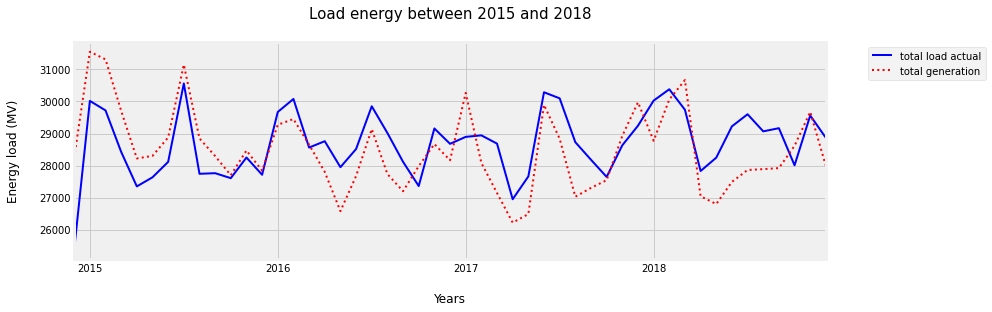

In [45]:
#Plot energy demande along 4 years
energy[['total load actual']].resample('M').mean().plot(style=['b'],figsize=(12,4), linewidth=2)
energy[['generation fossil','generation hydro', 'generation other','generation wind', 'generation solar','generation nuclear']].sum(axis=1).resample('M').mean().plot(style='r:', linewidth=2, label='total generation')
plt.legend(bbox_to_anchor=(1.05, 1),loc= 'upper left')
plt.title('Load energy between 2015 and 2018\n', fontsize=15)
plt.ylabel('Energy load (MV)\n')
plt.xlabel('\nYears')
plt.savefig(graphics_e +'generation_&_load_2018'+extension,  bbox_inches='tight');

El comportamiento de la generación y la demanda se producen de forma ajustada, puesto que la energía es un recurso que no se puede almacenar. Cuando hay demanda la generación tiene que cubrirla.

In [46]:
#Select row year 2018  and load columns
load_2018 = energy[energy.index.year == 2018]
load_2018[['total load actual']]

,total load actual
time,
2018-01-01 23:00:00,28084.0
2018-01-02 00:00:00,26180.0
2018-01-02 05:00:00,27911.0
2018-01-02 06:00:00,32762.0
2018-01-02 07:00:00,35344.0
...,...
2018-12-31 18:00:00,30653.0
2018-12-31 19:00:00,29735.0
2018-12-31 20:00:00,28071.0


Se utilizará los datos del último año para observar la demanda a lo largo de 2018, y se visulizarán las fechas de los festivos nacionales para determinar el efecto de estas en el consumos.

In [47]:
#Set date public holiday list
public_holiday = pd.Series(['2018-01-01', '2018-01-06','2018-03-30','2018-05-01','2018-08-15','2018-10-12','2018-11-01','2018-12-06','2018-12-25'])
public_holiday =public_holiday.apply(lambda x: np.datetime64(x, utc=True))
#Set description public holiday list
holiday_desc = pd.Series([ "New Year's Day", "Epiphany","Easter","Labor Day","Day Assumption of the Virgin","Hispanic Heritage Day","Halloween","Constitution Day","Christmas"])

# DataFrame public Holidays
holidays = pd.DataFrame({'date':public_holiday, 'desc_day': holiday_desc})

In [48]:
holidays

,date,desc_day
0,2018-01-01,New Year's Day
1,2018-01-06,Epiphany
2,2018-03-30,Easter
3,2018-05-01,Labor Day
4,2018-08-15,Day Assumption of the Virgin
5,2018-10-12,Hispanic Heritage Day
6,2018-11-01,Halloween
7,2018-12-06,Constitution Day
8,2018-12-25,Christmas


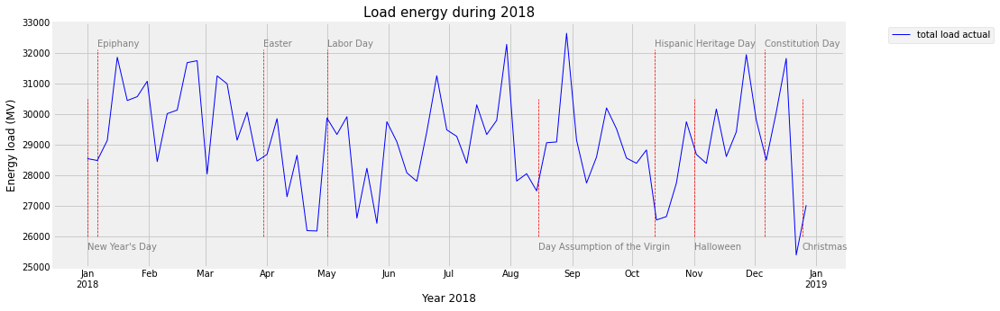

In [49]:
#Plot line graph energy load_demand and holidays during 2018
holiday_desc = pd.Series([ "New Year's Day", "Epiphany","Easter","Labor Day","Day Assumption of the Virgin","Hispanic Heritage Day","Halloween","Constitution Day","Christmas"])

y_lim_max_line = [30500, 32100,32100,32100,30500,32100,30500, 32100, 30500]
y_position_text = [25550,32200,32200,32200,25550,32200,25550,32200,25550]

load_2018[['total load actual']].resample('5D').mean().plot(style=['b-','r:'], figsize=(14,5), linewidth=1)
plt.legend(bbox_to_anchor=(1.05, 1),loc= 'upper left')
for i in range(len(public_holiday)):
    plt.vlines(public_holiday[i], ymin=26000, ymax= y_lim_max_line[i], ls='--', color='red', linewidth=0.75)
    # Add labels to the plot
    plt.text(public_holiday[i], y_position_text[i], holiday_desc[i], size=10, color='gray')

plt.title('Load energy during 2018', fontsize=15)
plt.ylabel('Energy load (MV)')
plt.xlim('2017-12-15','2019-01-15')

plt.ylim(25000,33000)
plt.xlabel('Year 2018'); 
plt.savefig(graphics_e +'holydays_&_load_2018'+extension,  bbox_inches='tight');

Con esta gráfica se puede apreciar que existe un efecto directo en la demanda energetica durante las fiestas y los periodos vacacionales.

Ahora con una gráfica de calor, se visualizará la demanda durante el intervalo de una semana, para poder observar las horas de más pico y valle energético.

In [50]:
# Get datas real load of 2018
actual_load_2018 = load_2018['total load actual']
actual_load_2018.head()

time
2018-01-01 23:00:00    28084.0
2018-01-02 00:00:00    26180.0
2018-01-02 05:00:00    27911.0
2018-01-02 06:00:00    32762.0
2018-01-02 07:00:00    35344.0
Name: total load actual, dtype: float64

In [51]:
# Create a new dataframe to load work
actual_load_2018 = pd.DataFrame(actual_load_2018)

In [52]:
#create new column containing the day of the week. 
actual_load_2018['day_of_week'] = actual_load_2018.index.dayofweek

#Constant, dictionary of the day of the week {num: name}
DAY_OF_WEEK = {0:'Monday',1:'Tuesday',2:'Wednesday',3:'Thursday',4:'Friday',5:'Saturday',6:'Sunday'}

In [53]:
#create new column containing hour of the day
actual_load_2018['hours'] = actual_load_2018.index.hour

In [54]:
actual_load_2018[:5]

,total load actual,day_of_week,hours
time,,,
2018-01-01 23:00:00,28084.0,0,23
2018-01-02 00:00:00,26180.0,1,0
2018-01-02 05:00:00,27911.0,1,5
2018-01-02 06:00:00,32762.0,1,6
2018-01-02 07:00:00,35344.0,1,7


In [55]:
# Create dataFrame it plot heatmap of energy demand
actual_load_week = actual_load_2018.groupby(['day_of_week','hours']).mean()
#round values of load
actual_load_week['total load actual'] = (actual_load_week['total load actual']).apply(lambda x : round(x))
actual_load_week

total load actual
day_of_week hours                   
0           0                  23405
            1                  22733
            2                  22475
            3                  22747
            4                  24280
...                              ...
6           19                 30665
            20                 30272
            21                 28524
            22                 26638
            23                 24688

[168 rows x 1 columns]

In [56]:
hours_of_week = pd.DataFrame()

In [57]:
for idx, data in actual_load_week.groupby(level=0):
    #print('---')
    #print(idx)
    #print(type(data))
    #print(data['actual_load_week'])
    hours_of_week['day_week_'+str(idx)] = list(data['total load actual'])

In [58]:
#Check dataFrame with mean datas of the week
hours_of_week

,day_week_0,day_week_1,day_week_2,day_week_3,day_week_4,day_week_5,day_week_6
0,23405,24338,24525,24621,24585,24469,23283
1,22733,23559,23788,23891,23871,23613,22378
2,22475,23227,23489,23592,23555,23139,21886
3,22747,23316,23652,23745,23714,23021,21754
4,24280,24471,24901,25084,25057,23517,22244
5,26962,26744,27378,27339,27340,24740,23142
6,29592,29265,30135,29828,29780,26539,24419
7,31650,31046,32038,31669,31528,28464,25988
8,32834,32216,33174,32790,32758,30113,27489
9,33525,32775,33738,33380,33512,31001,28651


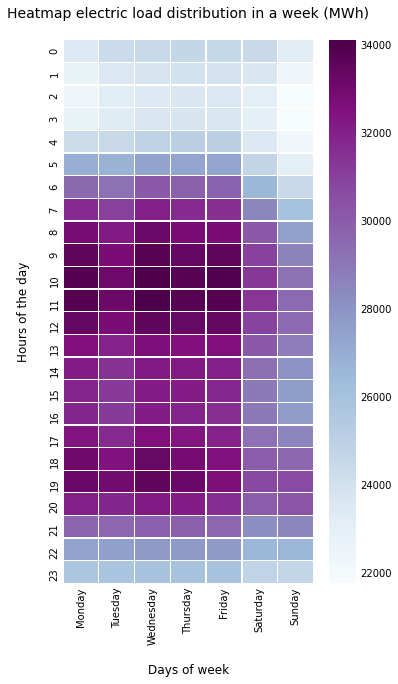

In [59]:
#plot heatmap of electric load in a week
f, ax = plt.subplots(figsize=(5,10))
sns.heatmap(hours_of_week, annot=False, cmap= "BuPu",  linewidths=0.3) 
ax.set_title('Heatmap electric load distribution in a week (MWh)\n', fontsize=14);
ax.set_xlabel('\nDays of week')
ax.set_ylabel('Hours of the day\n')
ax.set_xticklabels(list(DAY_OF_WEEK.values()))
plt.savefig(graphics_e +'heatmap_load_weeks_2018'+extension,  bbox_inches='tight');

##### Precio

Para el precio que es el atributo 'target' para establecer el modelo de este exploratorio, también se va hacer uso de un mapa de calor.

In [60]:
# Get datas price of 2018
price_2018 = energy_2018['price actual']
price_2018.head()

time
2018-01-01 23:00:00    29.42
2018-01-02 00:00:00    23.58
2018-01-02 05:00:00    35.01
2018-01-02 06:00:00    50.65
2018-01-02 07:00:00    58.61
Name: price actual, dtype: float64

In [61]:
# Create a new dataframe to prices work
price_2018 = pd.DataFrame(price_2018)

In [62]:
price_2018.iloc[:10,:]

,price actual
time,
2018-01-01 23:00:00,29.42
2018-01-02 00:00:00,23.58
2018-01-02 05:00:00,35.01
2018-01-02 06:00:00,50.65
2018-01-02 07:00:00,58.61
2018-01-02 08:00:00,57.43
2018-01-02 09:00:00,60.31
2018-01-02 10:00:00,58.48
2018-01-02 11:00:00,57.08


In [63]:
#create new column containing hour of the day
price_2018['hours'] = price_2018.index.hour

In [64]:
#create new column containing the day of the week
price_2018['day_of_week'] = price_2018.index.dayofweek

In [65]:
price_2018

,price actual,hours,day_of_week
time,,,
2018-01-01 23:00:00,29.42,23,0
2018-01-02 00:00:00,23.58,0,1
2018-01-02 05:00:00,35.01,5,1
2018-01-02 06:00:00,50.65,6,1
2018-01-02 07:00:00,58.61,7,1
...,...,...,...
2018-12-31 18:00:00,77.02,18,0
2018-12-31 19:00:00,76.16,19,0
2018-12-31 20:00:00,74.30,20,0


In [66]:
# Create dataFrame it plot heatmap of energy demand
price_week = price_2018.groupby(['day_of_week','hours']).mean()
price_week

price actual
day_of_week hours              
0           0         55.806327
            1         54.092653
            2         53.486735
            3         54.246327
            4         58.687959
...                         ...
6           19        69.598125
            20        69.009412
            21        65.666471
            22        63.111400
            23        59.279000

[168 rows x 1 columns]

In [67]:
hours_of_week = pd.DataFrame()

In [68]:
for idx, data in price_week.groupby(level=0):
    hours_of_week['day_week_'+str(idx)] = list(data['price actual'])

In [69]:
#Check dataFrame with mean datas of the week
hours_of_week

,day_week_0,day_week_1,day_week_2,day_week_3,day_week_4,day_week_5,day_week_6
0,55.806327,56.446400,57.613600,58.383542,58.046275,59.927447,58.364694
1,54.092653,55.872245,56.388800,56.807500,56.930600,58.305745,56.790612
2,53.486735,55.080612,55.461200,56.197292,56.141800,57.575319,55.626250
3,54.246327,55.048200,55.184800,56.551250,56.391400,56.585000,54.900000
4,58.687959,58.548039,58.534490,59.577083,59.870000,56.960625,54.733878
5,63.099020,62.136731,63.154898,62.844510,63.992400,57.529792,54.678200
6,68.098163,67.353462,67.664231,67.417308,68.592653,59.469375,56.125000
7,70.454792,70.124000,70.355490,69.603137,71.206667,62.169375,57.905200
8,70.651667,70.077800,70.680816,70.220980,71.104583,64.288571,59.421224
9,70.816531,70.654400,70.646400,70.580980,71.107600,65.483673,60.992449


In [70]:
hours_of_week = hours_of_week.apply(lambda x: round(x,2))

In [71]:
hours_of_week

,day_week_0,day_week_1,day_week_2,day_week_3,day_week_4,day_week_5,day_week_6
0,55.81,56.45,57.61,58.38,58.05,59.93,58.36
1,54.09,55.87,56.39,56.81,56.93,58.31,56.79
2,53.49,55.08,55.46,56.20,56.14,57.58,55.63
3,54.25,55.05,55.18,56.55,56.39,56.58,54.90
4,58.69,58.55,58.53,59.58,59.87,56.96,54.73
5,63.10,62.14,63.15,62.84,63.99,57.53,54.68
6,68.10,67.35,67.66,67.42,68.59,59.47,56.12
7,70.45,70.12,70.36,69.60,71.21,62.17,57.91
8,70.65,70.08,70.68,70.22,71.10,64.29,59.42
9,70.82,70.65,70.65,70.58,71.11,65.48,60.99


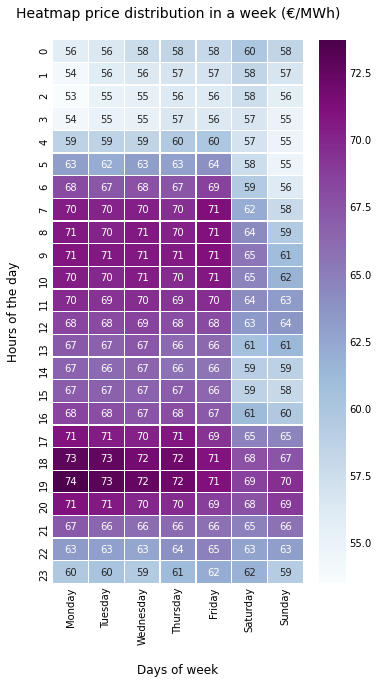

In [72]:
#plot heatmap of electric price in a week
f, ax = plt.subplots(figsize=(5,10))
sns.heatmap(hours_of_week, annot=True, cmap= "BuPu",  linewidths=0.3) 
ax.set_title('Heatmap price distribution in a week (€/MWh)\n', fontsize=14);
ax.set_xlabel('\nDays of week')
ax.set_ylabel('Hours of the day\n')
ax.set_xticklabels(list(DAY_OF_WEEK.values()));
plt.savefig(graphics_e +'heatmap_price_weeks_2018'+extension,  bbox_inches='tight');

Las oscilaciones de los precios en los intervalos horarios durante una semana son prácticamente iguales a las variaciones de demanda energética en dicho momento.

En ambos gráficos se muestra con claridad que el pico de mayor uso energético es de lunes a jueves de 7:00a 11:00h y, por la tarde, entre las 17:00 y 20:00h. 

Durante el horario laboral existe una alta demanda ,y el momento de menor precio es por las noche entre la 1:00 y las 3:00h.

Visualizamos la fluctuación del precio a lo largo de todo un día, teniendo en cuenta los 7 días de la semana.

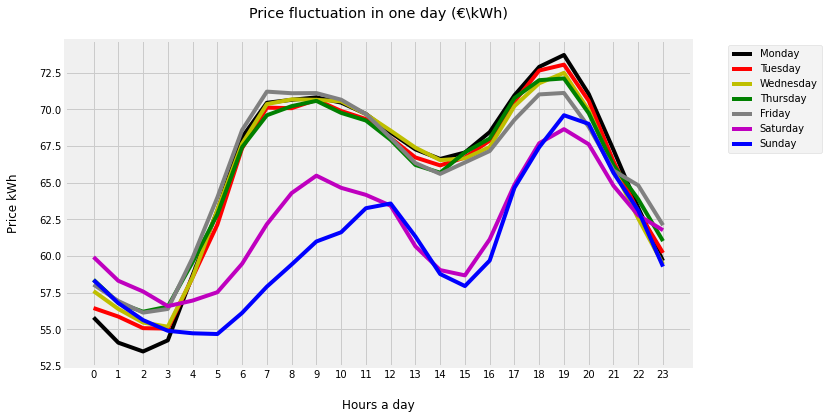

In [73]:
hours_of_week.plot(figsize=(10,6), color = ['k','r','y','g','grey','m','b'])
plt.legend(bbox_to_anchor=(1.05, 1),loc= 'upper left', labels= list(DAY_OF_WEEK.values()))
plt.title('Price fluctuation in one day (€\kWh)\n')
plt.xlabel("\nHours a day")
plt.xticks(np.arange(24))
plt.ylabel("Price kWh\n");
plt.savefig(graphics_e +'price_fluctuation_daysofweek_2018'+extension,  bbox_inches='tight');

In [74]:
fig = go.Figure()


monday = go.Scatter(
                    x=hours_of_week.index,
                    y=hours_of_week.day_week_0.values,
                    mode='lines',
                    name='Monday',
                    marker=dict(color='#f94144'),
                    line = dict(width=3))

tuesday = go.Scatter(x=hours_of_week.index,
                    y=hours_of_week.day_week_1.values,
                    mode='lines',
                    name='Tuesday',
                    marker=dict(color='#577590'),
                    line = dict(width=3))

wednesday = go.Scatter(x=hours_of_week.index,
                    y=hours_of_week.day_week_2.values,
                    mode='lines',
                    name='Wednesday',
                    marker=dict(color='#3E6AF5'),
                    line = dict(width=3))

tuesday = go.Scatter(x=hours_of_week.index,
                    y=hours_of_week.day_week_3.values,
                    mode='lines',
                    name='Thursday',
                    marker=dict(color='#F268F1'),
                    line = dict(width=3))

friday = go.Scatter(x=hours_of_week.index,
                    y=hours_of_week.day_week_4.values,
                    mode='lines',
                    name='Friday',
                    marker=dict(color='#37EB18'),
                    line = dict(width=3))

saturday = go.Scatter(x=hours_of_week.index,
                    y=hours_of_week.day_week_5.values,
                    mode='lines',
                    name='Saturday',
                    marker=dict(color='#F5B918'),
                    line = dict(width=3))

sunday = go.Scatter(x=hours_of_week.index,
                    y=hours_of_week.day_week_6.values,
                    mode='lines',
                    name='Sunday',
                    marker=dict(color='#31F5E5'),
                    line = dict(width=3))

data=[monday, tuesday,wednesday,tuesday,friday,saturday,sunday]

layout = dict(title='Price fluctuation in one day (€\kWh)',
             xaxis=dict(title="Hours a day", ticklen=24),
             yaxis=dict(title="Price KWh"))

fig = dict(data=data, layout = layout)
iplot(fig)


### Weather

En este paso se realizará la manipulación correspondiente al dataFrame 'weather'.

Se modifica el tipo de dato de la serie 'dt_iso' a numpy.datetime64 manteniendo el utc, aunque se desea utlizar el dato de fecha/hora como índice puesto que será el atributo por el que se vincule ambos datasets, de momento se mantiene el generado automáticamente por números correlativos enteros para realizar diferentes operaciones de limpieza.

In [84]:
weather = pd.read_csv('weather_features.csv')

In [85]:
weather.head(2)

,dt_iso,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,2015-01-01 00:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n
1,2015-01-01 01:00:00+01:00,Valencia,270.475,270.475,270.475,1001,77,1,62,0.0,0.0,0.0,0,800,clear,sky is clear,01n


In [86]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178396 entries, 0 to 178395
Data columns (total 17 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   dt_iso               178396 non-null  object 
 1   city_name            178396 non-null  object 
 2   temp                 178396 non-null  float64
 3   temp_min             178396 non-null  float64
 4   temp_max             178396 non-null  float64
 5   pressure             178396 non-null  int64  
 6   humidity             178396 non-null  int64  
 7   wind_speed           178396 non-null  int64  
 8   wind_deg             178396 non-null  int64  
 9   rain_1h              178396 non-null  float64
 10  rain_3h              178396 non-null  float64
 11  snow_3h              178396 non-null  float64
 12  clouds_all           178396 non-null  int64  
 13  weather_id           178396 non-null  int64  
 14  weather_main         178396 non-null  object 
 15  weather_descripti

In [87]:
weather['dt_iso'] = weather['dt_iso'].apply(lambda x: np.datetime64(x, utc=True))

#weather.set_index('dt_iso', drop=False, inplace=True)

# modify the column name
weather.rename(columns={"dt_iso": "time"}, inplace= True)

C:\Users\pilar\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning:

parsing timezone aware datetimes is deprecated; this will raise an error in the future



In [88]:
weather.tail()

,time,city_name,temp,temp_min,temp_max,pressure,humidity,wind_speed,wind_deg,rain_1h,rain_3h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
178391,2018-12-31 18:00:00,Seville,287.76,287.15,288.15,1028,54,3,30,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178392,2018-12-31 19:00:00,Seville,285.76,285.15,286.15,1029,62,3,30,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178393,2018-12-31 20:00:00,Seville,285.15,285.15,285.15,1028,58,4,50,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178394,2018-12-31 21:00:00,Seville,284.15,284.15,284.15,1029,57,4,60,0.0,0.0,0.0,0,800,clear,sky is clear,01n
178395,2018-12-31 22:00:00,Seville,283.97,282.15,285.15,1029,70,3,50,0.0,0.0,0.0,0,800,clear,sky is clear,01n


Se elimina los atributos de 'temp_min' y 'temp_max', puesto que disponemos de un valor general de temperatura durante ese intervalo de hora.

La columna categórica de 'weather_description' debido a que tenemos una clasificación principal del 'tiempo' se elimina del conjunto de datos, y también 'weather_icon' que los valores que tiene la API como imagen de representación del tiempo.

Se descarta la columna de orientación del viento puesto que es un atributo que sería importante dependiendo de la ubicación del parque eólico y los flujos de corrientes de la zona,y como inciden en la generación con respecto a otros parques, pero no se considerará en este caso a nivel nacional.

In [89]:
weather.drop(['temp_min', 'temp_max','wind_deg','weather_description','weather_icon'], axis=1, inplace=True)

Se revisa el montante de los datos de lluvia recogida en '1h'y en las 3h (mm/h), para cuantificar el volumen y su peso en el conjunto de datos.

Teniendo en cuenta que estos datos están recogiendo la inforación de agua en sólo 5 puntos de todo el territorio y su dimensión no es significativa, se decide acumularlas con los registros de lluvia que existen de 1h.  

Se acumulan en una sola serie, se con el nombre de 'water_collected'.

In [90]:
# water collected in 5 different places within Spain
weather[['rain_1h','rain_3h','snow_3h']].sum()

rain_1h    13467.4400
rain_3h       67.7485
snow_3h      849.6850
dtype: float64

In [91]:
water_collected  = weather[['rain_1h','rain_3h','snow_3h']].sum(axis=1)

weather.insert(loc=6, column= 'water_collected', value = water_collected)
weather.drop(columns =['rain_1h','rain_3h','snow_3h'], inplace= True)

In [92]:
weather.head()

,time,city_name,temp,pressure,humidity,wind_speed,water_collected,clouds_all,weather_id,weather_main
0,2014-12-31 23:00:00,Valencia,270.475,1001,77,1,0.0,0,800,clear
1,2015-01-01 00:00:00,Valencia,270.475,1001,77,1,0.0,0,800,clear
2,2015-01-01 01:00:00,Valencia,269.686,1002,78,0,0.0,0,800,clear
3,2015-01-01 02:00:00,Valencia,269.686,1002,78,0,0.0,0,800,clear
4,2015-01-01 03:00:00,Valencia,269.686,1002,78,0,0.0,0,800,clear


In [93]:
weather.describe()

,temp,pressure,humidity,wind_speed,water_collected,clouds_all,weather_id
count,178396.000000,1.783960e+05,178396.000000,178396.00000,178396.000000,178396.000000,178396.000000
mean,289.618605,1.069261e+03,68.423457,2.47056,0.080635,25.073292,759.831902
std,8.026199,5.969632e+03,21.902888,2.09591,0.464530,30.774129,108.733223
min,262.240000,0.000000e+00,0.000000,0.00000,0.000000,0.000000,200.000000
25%,283.670000,1.013000e+03,53.000000,1.00000,0.000000,0.000000,800.000000
50%,289.150000,1.018000e+03,72.000000,2.00000,0.000000,20.000000,800.000000
75%,295.150000,1.022000e+03,87.000000,4.00000,0.000000,40.000000,801.000000
max,315.600000,1.008371e+06,100.000000,133.00000,21.800000,100.000000,804.000000


In [94]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178396 entries, 0 to 178395
Data columns (total 10 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   time             178396 non-null  datetime64[ns]
 1   city_name        178396 non-null  object        
 2   temp             178396 non-null  float64       
 3   pressure         178396 non-null  int64         
 4   humidity         178396 non-null  int64         
 5   wind_speed       178396 non-null  int64         
 6   water_collected  178396 non-null  float64       
 7   clouds_all       178396 non-null  int64         
 8   weather_id       178396 non-null  int64         
 9   weather_main     178396 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 13.6+ MB


##### Conversor de temperatura

Los datos de la serie de temperatura están registrados en grados 'kelvin', se realiza conversión a grados 'celsius' que son la métrica con la que estamos más familiarizados.

In [95]:
#converter to degrees celsius from degrees kelvin
weather['temp'] = round(weather['temp'] - 273, 2)

In [96]:
weather['temp'][25:35]

25   -1.77
26   -2.34
27   -2.34
28   -2.34
29   -2.72
30   -2.72
31   -2.72
32    1.43
33    1.43
34    1.43
Name: temp, dtype: float64

#### Exploración atributos y tratamiento datos 'weather'

##### Histograma y densidad de probabilidad

En este punto se explorará los datos de cada columna, y eliminar datos fuera de rango.

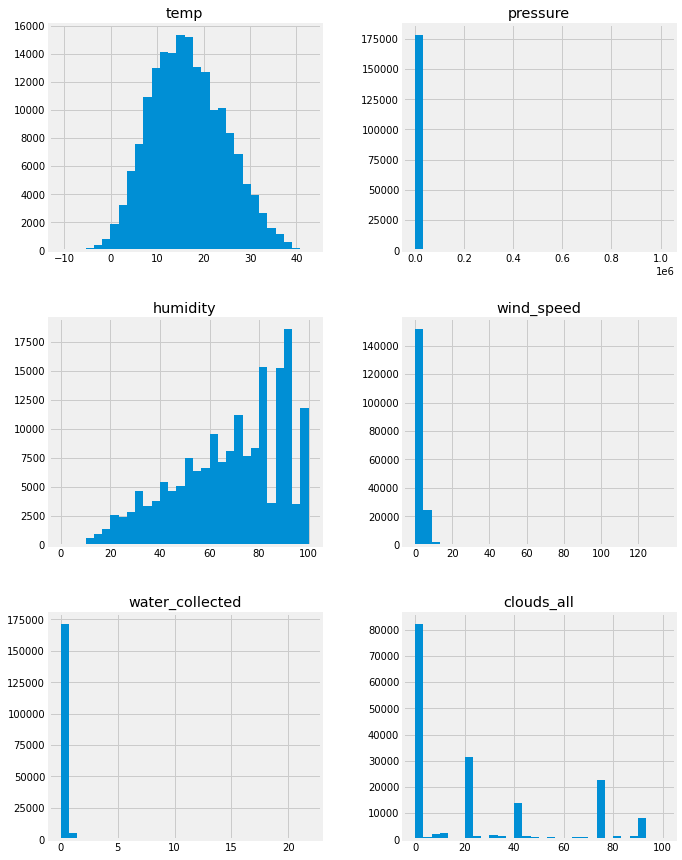

In [97]:
# histogram of attributes
weather.iloc[:,2:8].hist(figsize=(10,15), bins=30)
plt.savefig(graphics_w +'weather_hist'+extension);

TEMP


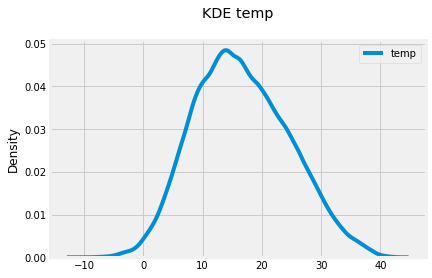

PRESSURE


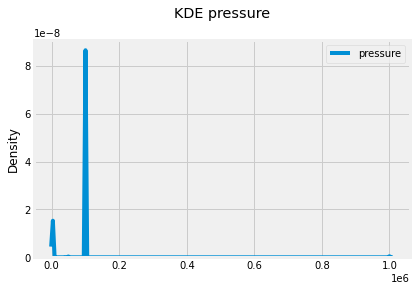

HUMIDITY


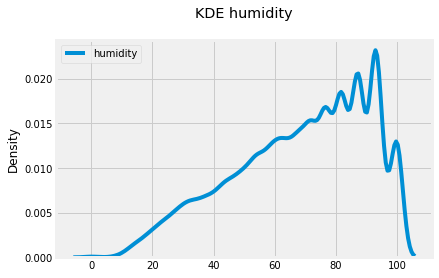

WIND_SPEED


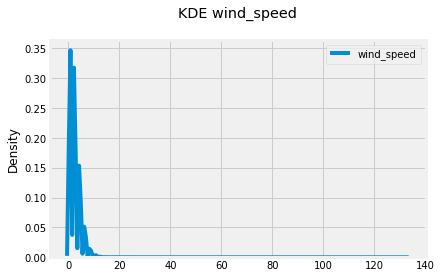

WATER_COLLECTED


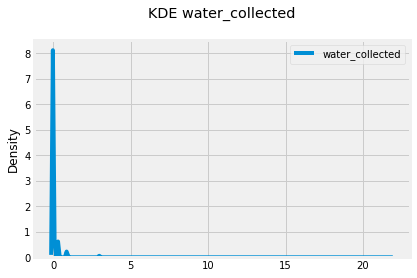

CLOUDS_ALL


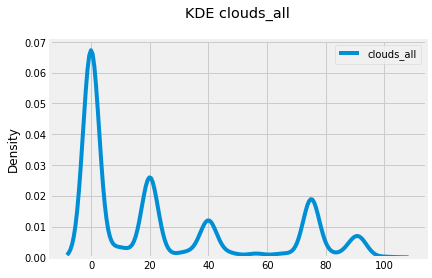

In [98]:
#Boxplot columns weather
for i in weather.columns[2:8]:
    print(i.upper())
    sns.kdeplot(data=weather.loc[:,[i]])
    
    plt.title(f'KDE {i}\n');
    plt.savefig(graphics_w +'/kde/'+'weather_kde_'+i+extension);
    plt.show()

Una vez visto los histogramas de las columnas, existe varios atributos que destacan por su oscilación de valores:
    
    1.- Pressure
    2.- Wind Speed
    2.- Water collected
    
El gráfico de de caja nos dará más información a la hora de identificar 'outlayer' de las columnas de 'weather', así se podrán limpiar para obtener el dataset final.

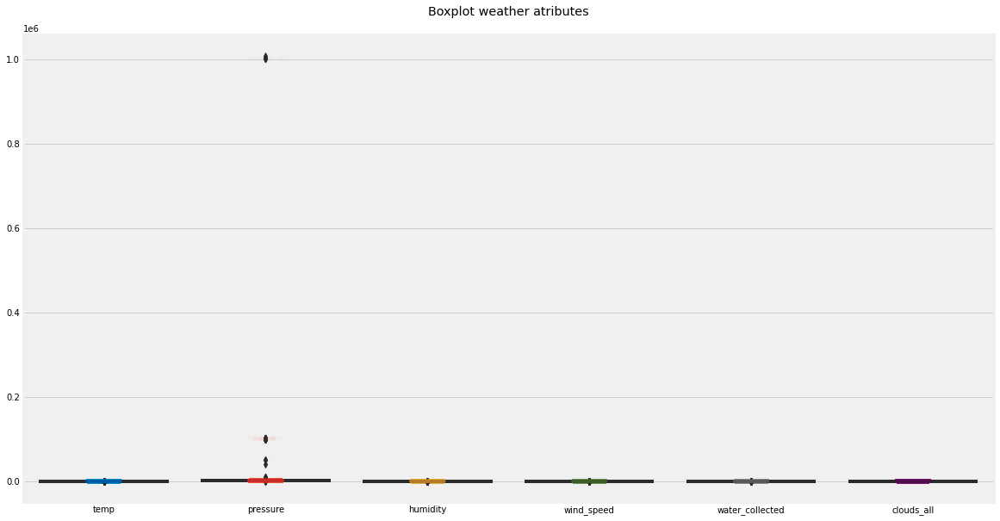

In [99]:
#Boxplot columns weather
plt.subplots(figsize=(18,10))
sns.boxplot(data=weather.iloc[:,2:8] )
sns.stripplot(data=weather.iloc[:,2:8], alpha=0.02)
plt.title('Boxplot weather atributes\n');
plt.savefig(graphics_w +'weather_boxplot'+extension);

TEMP


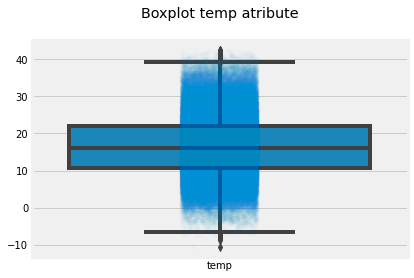

PRESSURE


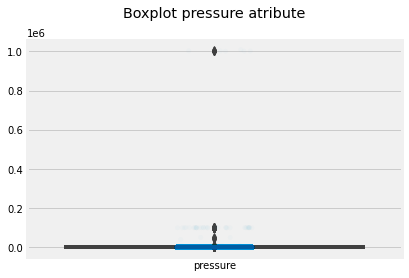

HUMIDITY


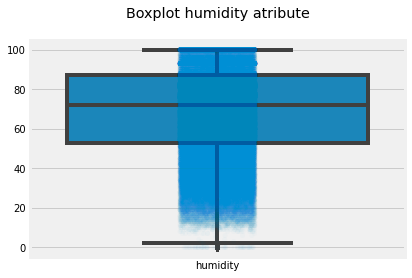

WIND_SPEED


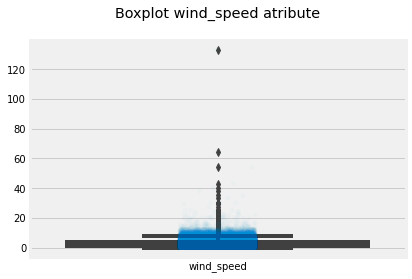

WATER_COLLECTED


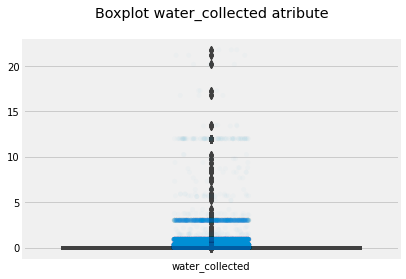

CLOUDS_ALL


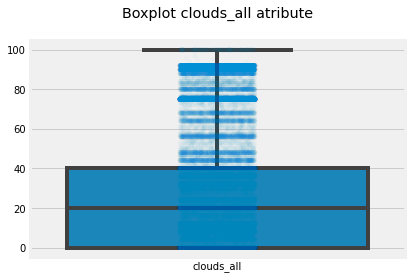

In [100]:
#Boxplot columns weather
for i in weather.columns[2:8]:
    print(i.upper())
    sns.boxplot(data=weather.loc[:,[i]])
    sns.stripplot(data=weather.loc[:,[i]], alpha=0.02)
    plt.title(f'Boxplot {i} atribute\n');
    plt.savefig(graphics_w +'/boxplot/'+'weather_boxplot_'+i+extension);
    plt.show()

Según el gráfico de cajas hay un claro atributo que tiene valores que pueden llegar a distorsionar en exceso el resultado de la computación.

La serie 'pressure' posee outlayers con valores elevadísimos. Al visualizar los datos estadísticos de cada atributo, en 'pressure' se observa que tiene una disviación de casi 6000hPa. cuando su media, su mediana y los cuartiles 25% y 75% están entorno a 1.000 hPa.

#### Tratamiento de outlayers

Para la limpieza de outlayer del dataframe no se tienen en cuenta las columnas que son categoricas.

In [101]:
#categoric columns
weather_cat = pd.concat([weather.iloc[:,:2],weather.iloc[:,-2:]], axis=1, sort=False)
weather_cat

,time,city_name,weather_id,weather_main
0,2014-12-31 23:00:00,Valencia,800,clear
1,2015-01-01 00:00:00,Valencia,800,clear
2,2015-01-01 01:00:00,Valencia,800,clear
3,2015-01-01 02:00:00,Valencia,800,clear
4,2015-01-01 03:00:00,Valencia,800,clear
...,...,...,...,...
178391,2018-12-31 18:00:00,Seville,800,clear
178392,2018-12-31 19:00:00,Seville,800,clear
178393,2018-12-31 20:00:00,Seville,800,clear
178394,2018-12-31 21:00:00,Seville,800,clear


In [102]:
# numeric columns
weather.iloc[:,2:8]

,temp,pressure,humidity,wind_speed,water_collected,clouds_all
0,-2.52,1001,77,1,0.0,0
1,-2.52,1001,77,1,0.0,0
2,-3.31,1002,78,0,0.0,0
3,-3.31,1002,78,0,0.0,0
4,-3.31,1002,78,0,0.0,0
...,...,...,...,...,...,...
178391,14.76,1028,54,3,0.0,0
178392,12.76,1029,62,3,0.0,0
178393,12.15,1028,58,4,0.0,0
178394,11.15,1029,57,4,0.0,0


In [103]:
 # numeric atrubutres
weather.columns[2:-2]

Index(['temp', 'pressure', 'humidity', 'wind_speed', 'water_collected',
       'clouds_all'],
      dtype='object')

In [104]:
#Delete rows have outlayers, use functions_EDA module
for i in weather.columns[2:8]:
    print(i.upper())
    weather = f_eda.drop_outlayers_df(weather, i)
    #weather = drop_outlayers_df(weather,i)
    print('Delete', i,'outlayers, length dataframe is ',weather.shape[0])
    print('\n')

TEMP
Delete temp outlayers, length dataframe is  178203


PRESSURE
Delete pressure outlayers, length dataframe is  166406


HUMIDITY
Delete humidity outlayers, length dataframe is  166391


WIND_SPEED
Delete wind_speed outlayers, length dataframe is  164239


WATER_COLLECTED
Delete water_collected outlayers, length dataframe is  145433


CLOUDS_ALL
Delete clouds_all outlayers, length dataframe is  124995




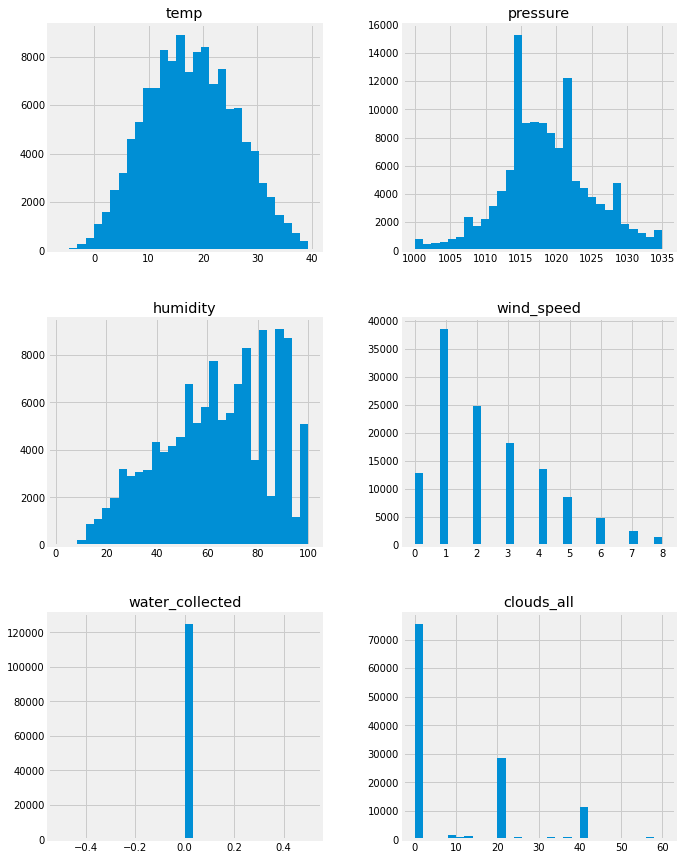

In [105]:
# histogram of attributes
weather.iloc[:,2:8].hist(figsize=(10,15), bins=30);
plt.savefig(graphics_w+ 'without_outlayers/' +'weather_hist'+extension);

TEMP


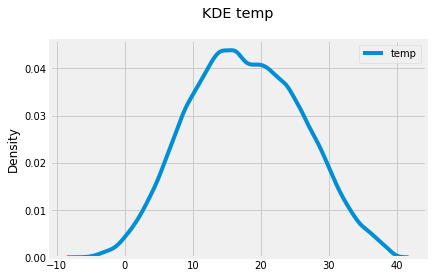

PRESSURE


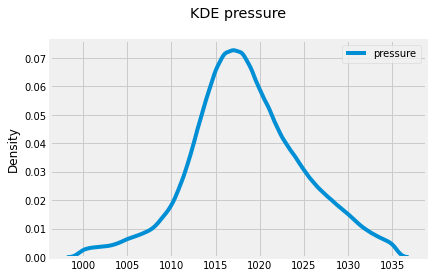

HUMIDITY


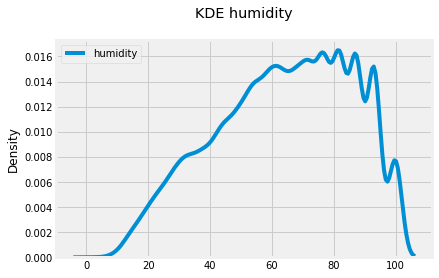

WIND_SPEED


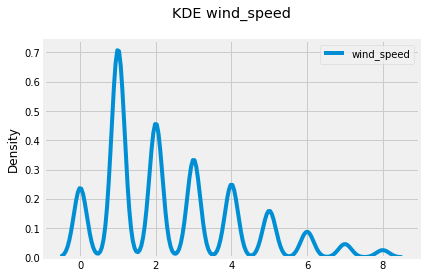

WATER_COLLECTED


C:\Users\pilar\Anaconda3\lib\site-packages\seaborn\distributions.py:305: UserWarning:

Dataset has 0 variance; skipping density estimate.



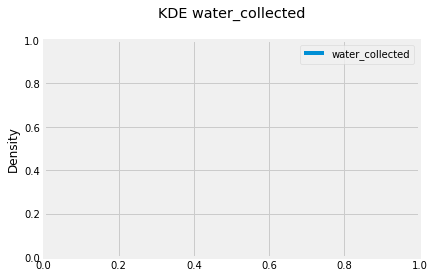

CLOUDS_ALL


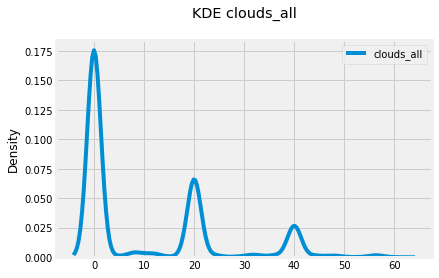

In [106]:
#Boxplot columns weather
for i in weather.columns[2:8]:
    print(i.upper())
    sns.kdeplot(data=weather.loc[:,[i]])
    
    plt.title(f'KDE {i}\n');
    plt.savefig(graphics_w +'/kde/'+'without_outlayers/'+'weather_kde_'+i+extension);
    plt.show()

TEMP


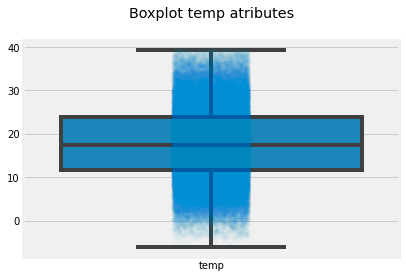

PRESSURE


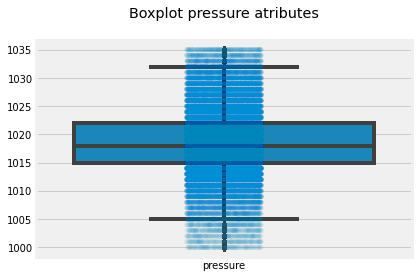

HUMIDITY


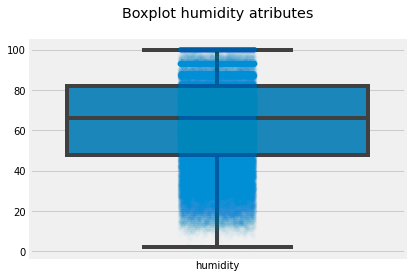

WIND_SPEED


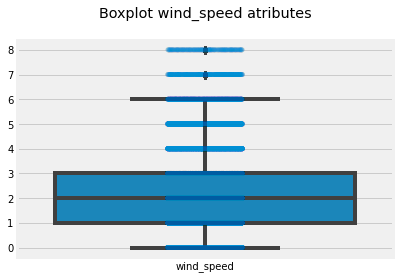

WATER_COLLECTED


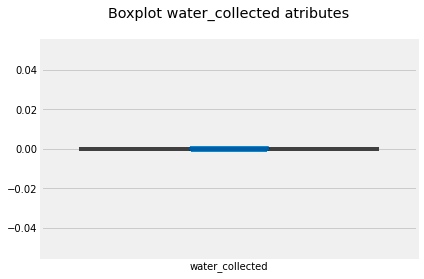

CLOUDS_ALL


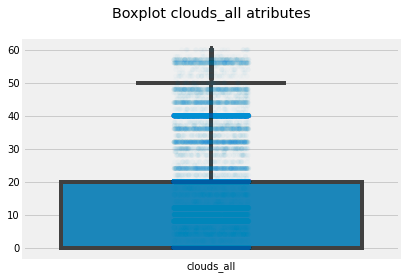

In [107]:
#Boxplot columns weather
for i in weather.columns[2:8]:
    print(i.upper())
    sns.boxplot(data=weather.loc[:,[i]])
    sns.stripplot(data=weather.loc[:,[i]], alpha=0.02)
    plt.title(f'Boxplot {i} atributes\n');
    plt.savefig(graphics_w +'boxplot/without_outlayers/'+'weather_boxplot_'+i+extension);
    plt.show()


#### Indices

En este paso se comprobará los índices y se tratarán para que en ambos datasets coincidan, con la finalidad de unirlos a través de esta columna.

In [108]:
weather.index

Int64Index([     0,      1,      2,      3,      4,      5,      6,      7,
                 8,      9,
            ...
            178386, 178387, 178388, 178389, 178390, 178391, 178392, 178393,
            178394, 178395],
           dtype='int64', length=124995)

Como se había comentado al inicio del estudio del dataset 'weather', la fecha y hora será  la columna por la que se realizará la unión con el dataset 'energy'. 

En este momento se fija como index la serie temporal.

In [109]:
weather.set_index('time', inplace=True, drop=False)

In [110]:
weather.tail()

,time,city_name,temp,pressure,humidity,wind_speed,water_collected,clouds_all,weather_id,weather_main
time,,,,,,,,,,
2018-12-31 18:00:00,2018-12-31 18:00:00,Seville,14.76,1028,54,3,0.0,0,800,clear
2018-12-31 19:00:00,2018-12-31 19:00:00,Seville,12.76,1029,62,3,0.0,0,800,clear
2018-12-31 20:00:00,2018-12-31 20:00:00,Seville,12.15,1028,58,4,0.0,0,800,clear
2018-12-31 21:00:00,2018-12-31 21:00:00,Seville,11.15,1029,57,4,0.0,0,800,clear
2018-12-31 22:00:00,2018-12-31 22:00:00,Seville,10.97,1029,70,3,0.0,0,800,clear


Se explora la serie. 

In [111]:
weather.index.is_unique

False

Se comprueba que en el conjunto de datos de indices de este dataFrame no son únicos, y por tanto, se explora la naturaleza de estos registros.

Se seleccionan 2 indices aletorios, para su observación.


In [112]:
weather.loc[np.random.choice(weather.index, size=2),:]

,time,city_name,temp,pressure,humidity,wind_speed,water_collected,clouds_all,weather_id,weather_main
time,,,,,,,,,,
2015-04-04 11:00:00,2015-04-04 11:00:00,Madrid,16.72,1014,38,4,0.0,0,800,clear
2015-04-04 11:00:00,2015-04-04 11:00:00,Seville,23.17,1010,49,2,0.0,0,800,clear
2017-10-09 19:00:00,2017-10-09 19:00:00,Valencia,22.15,1019,83,2,0.0,20,801,clouds
2017-10-09 19:00:00,2017-10-09 19:00:00,Madrid,23.15,1020,18,1,0.0,0,800,clear
2017-10-09 19:00:00,2017-10-09 19:00:00,Bilbao,15.60,1022,82,1,0.0,0,800,clear
2017-10-09 19:00:00,2017-10-09 19:00:00,Barcelona,21.15,1020,82,0,0.0,0,800,clear
2017-10-09 19:00:00,2017-10-09 19:00:00,Seville,28.15,1016,42,4,0.0,0,800,clear


In [148]:
weather['city_name'].unique()

array(['Valencia', 'Madrid', 'Bilbao', ' Barcelona', 'Seville'],
      dtype=object)

In [149]:
weather.shape[0], energy.shape[0]

(124995, 32229)

In [150]:
weather.index.nunique() 

34292

In [151]:
energy.index.shape[0]

32229

Los registros del dataset 'weather' que se ha descargado para el EDA, recogen sólo información climatológica de 1 a 5 puntos distintos( las ciudades de Valencia, Madrid, Bilbao, Barcelona, Sevilla) del territorio. 

Por tanto, en el mismo intervalo de dia_hora se pueden llegar a tener 5 filas repetidas con ese índice pero con diferentes valores en el resto de atributos.

En este momento se tiene que estudiar el mejor criterio a la hora de eliminar los registros duplicados del dataset 'weather' para que coincida con los indices de 'energy'.

Una de las opciones sería seleccionar una de las ciudades, por ejemplo 'Madrid' puesto que se encuentra en el punto central y a una altura intermedia del país, y eliminar el resto de filas que tienen duplicado el índice.

Pero se considera más interesante a la hora de descartar las duplicidades del índice, agrupandolos por su índice y extrayendo sus valores medios según los fenómenos atmosfericos.

In [113]:
weather.time

time
2014-12-31 23:00:00   2014-12-31 23:00:00
2015-01-01 00:00:00   2015-01-01 00:00:00
2015-01-01 01:00:00   2015-01-01 01:00:00
2015-01-01 02:00:00   2015-01-01 02:00:00
2015-01-01 03:00:00   2015-01-01 03:00:00
                              ...        
2018-12-31 18:00:00   2018-12-31 18:00:00
2018-12-31 19:00:00   2018-12-31 19:00:00
2018-12-31 20:00:00   2018-12-31 20:00:00
2018-12-31 21:00:00   2018-12-31 21:00:00
2018-12-31 22:00:00   2018-12-31 22:00:00
Name: time, Length: 124995, dtype: datetime64[ns]

In [114]:
weather.columns[2:-2]

Index(['temp', 'pressure', 'humidity', 'wind_speed', 'water_collected',
       'clouds_all'],
      dtype='object')

In [115]:
#unify values attributes with the same index
for index, value in weather.time.items():
    #print(value) #indexDateTime == values
    #print(weather.loc[value,:]) #DataFrame rows with the same index
    #print(type(weather.loc[value,:]))
    s_means = weather.loc[value,weather.columns[2]:weather.columns[7]].mean() #Serie with means of attributes
    
    if isinstance(weather.loc[value,:], pd.DataFrame):
        for column in weather.columns[2:-2]:
            #print(s_means[column])
            weather.loc[value,column] = s_means[column]
    
    #print('\n')

In [116]:
weather.loc[np.random.choice(weather.index, size=2),:]

,time,city_name,temp,pressure,humidity,wind_speed,water_collected,clouds_all,weather_id,weather_main
time,,,,,,,,,,
2015-12-23 05:00:00,2015-12-23 05:00:00,Valencia,4.210,1030.666667,88.333333,0.333333,0.0,6.666667,701,mist
2015-12-23 05:00:00,2015-12-23 05:00:00,Madrid,4.210,1030.666667,88.333333,0.333333,0.0,6.666667,800,clear
2015-12-23 05:00:00,2015-12-23 05:00:00,Seville,4.210,1030.666667,88.333333,0.333333,0.0,6.666667,801,clouds
2017-08-29 13:00:00,2017-08-29 13:00:00,Valencia,26.078,1014.000000,53.800000,1.600000,0.0,28.000000,802,clouds
2017-08-29 13:00:00,2017-08-29 13:00:00,Madrid,26.078,1014.000000,53.800000,1.600000,0.0,28.000000,802,clouds
2017-08-29 13:00:00,2017-08-29 13:00:00,Bilbao,26.078,1014.000000,53.800000,1.600000,0.0,28.000000,800,clear
2017-08-29 13:00:00,2017-08-29 13:00:00,Barcelona,26.078,1014.000000,53.800000,1.600000,0.0,28.000000,801,clouds
2017-08-29 13:00:00,2017-08-29 13:00:00,Seville,26.078,1014.000000,53.800000,1.600000,0.0,28.000000,802,clouds


Una vez los datos del mismo indice están unificados, se eliminarán los duplicados manteniendo el primer registro.

In [118]:
weather.drop_duplicates(subset ="time", keep ='first', inplace = True)

In [119]:
#Check outcome 'drop_duplicates'
weather.loc[np.random.choice(weather.index, size=2),:]

,time,city_name,temp,pressure,humidity,wind_speed,water_collected,clouds_all,weather_id,weather_main
time,,,,,,,,,,
2017-10-10 04:00:00,2017-10-10 04:00:00,Valencia,13.434,1019.4,83.60,0.40,0.0,0.0,800,clear
2016-09-26 07:00:00,2016-09-26 07:00:00,Valencia,18.220,1022.5,77.25,1.75,0.0,18.0,801,clouds


Ahora se eliminan las columnas categoricas de; 'city_name' y 'weather_id' y 'weather_mail', y también la columna DateTime de 'time'.

In [120]:
weather.drop(['time','city_name','weather_id','weather_main'], axis=1, inplace=True)

In [121]:
weather.head()

,temp,pressure,humidity,wind_speed,water_collected,clouds_all
time,,,,,,
2014-12-31 23:00:00,3.050000,1018.000000,88.500000,4.000000,0.0,0.0
2015-01-01 00:00:00,0.953333,1023.666667,91.333333,2.666667,0.0,0.0
2015-01-01 01:00:00,-3.310000,1002.000000,78.000000,0.000000,0.0,0.0
2015-01-01 02:00:00,-3.555000,1018.500000,87.500000,0.500000,0.0,0.0
2015-01-01 03:00:00,-3.410000,1018.500000,87.500000,0.500000,0.0,0.0


In [122]:
#round dataset float numbers
for col in weather.columns:
    print(col)
    weather[col] = weather[col].apply(lambda x: round(x,1))

weather.head()

temp
pressure
humidity
wind_speed
water_collected
clouds_all


,temp,pressure,humidity,wind_speed,water_collected,clouds_all
time,,,,,,
2014-12-31 23:00:00,3.0,1018.0,88.5,4.0,0.0,0.0
2015-01-01 00:00:00,1.0,1023.7,91.3,2.7,0.0,0.0
2015-01-01 01:00:00,-3.3,1002.0,78.0,0.0,0.0,0.0
2015-01-01 02:00:00,-3.6,1018.5,87.5,0.5,0.0,0.0
2015-01-01 03:00:00,-3.4,1018.5,87.5,0.5,0.0,0.0


Antes de iniciar la unión de los dos conjuntos de datos, verificamos si los índices són únicos.

In [123]:
weather.index.is_unique

True

In [124]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 34292 entries, 2014-12-31 23:00:00 to 2018-12-13 18:00:00
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   temp             34292 non-null  float64
 1   pressure         34292 non-null  float64
 2   humidity         34292 non-null  float64
 3   wind_speed       34292 non-null  float64
 4   water_collected  34292 non-null  float64
 5   clouds_all       34292 non-null  float64
dtypes: float64(6)
memory usage: 3.1 MB


In [125]:
weather.shape[0] 

34292

In [126]:
energy.shape[0]

32229

Verificamos cuantos Nan_values y que porcentaje de valores a '0' cero hay en cada columna.

In [127]:
weather.isnull().any()

temp               False
pressure           False
humidity           False
wind_speed         False
water_collected    False
clouds_all         False
dtype: bool

In [128]:
f_eda.percentage_zeros_columns(weather)

PERCENTAGE ZERO_VALUES OF COLUMNS DATAFRAME:

0.- temp : 0.017 %

1.- pressure : 0.0 %

2.- humidity : 0.0 %

3.- wind_speed : 0.321 %

4.- water_collected : 100.0 %

5.- clouds_all : 22.76 %



La serie 'water_collected' del dataframe después de eliminar los outlayer tiene todos los registros a '0', no aportará valor al modelo. Se elimina del conjunto de atributos del dataset.

In [129]:
weather.drop('water_collected', axis=1, inplace= True)

In [130]:
weather_2018 = weather[weather.index.year == 2018]

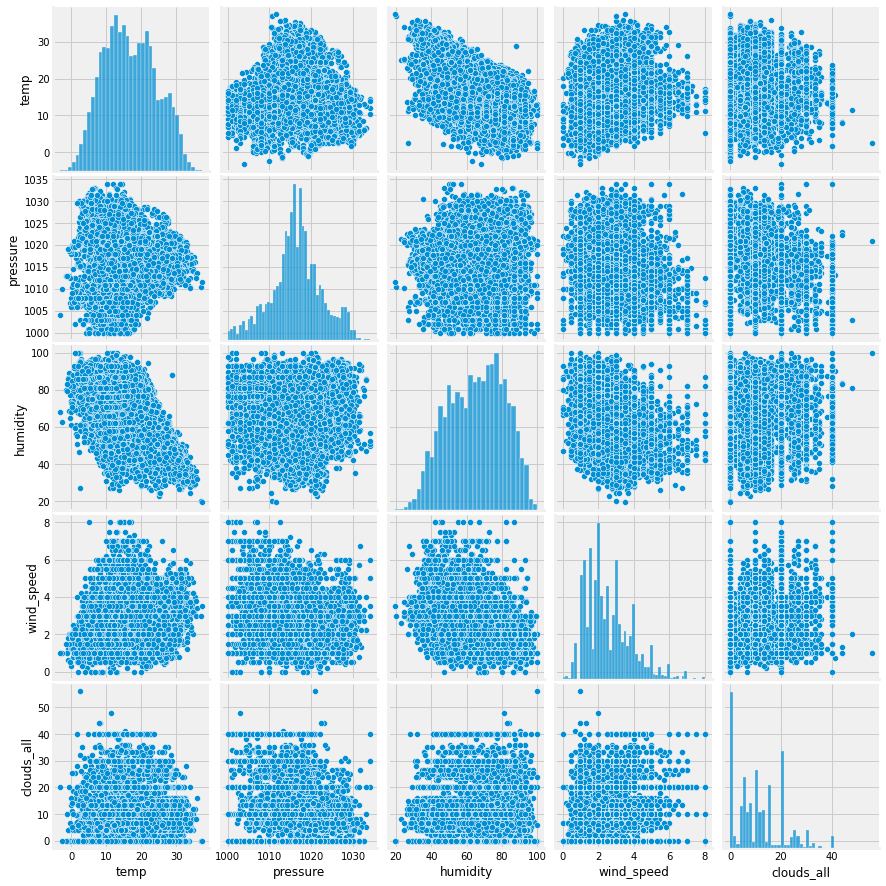

In [131]:
sns.pairplot(weather_2018)
plt.savefig(graphics_w +'without_outlayers/'+'weather_pairplot'+extension);

### Unión de los conjuntos de datos 'energy' y 'weather'

A partir de ahora se juntan los dos dataframes creando un nuevo dataframe utilizando los índices que coinciden. Descartamos las filas que no coinciden en ambos conjuntos dado que tenemos muchos registro y podemos descartar directamente los generarán Nan_values.

In [132]:
df = weather.merge(energy, left_on=weather.index, right_on=energy.index, how='inner')

In [133]:
df.head()

,key_0,temp,pressure,humidity,wind_speed,clouds_all,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,total load actual,price actual
0,2014-12-31 23:00:00,3.0,1018.0,88.5,4.0,0.0,10156.0,3813.0,7096.0,759.0,49.0,6378.0,25385.0,65.41
1,2015-01-01 00:00:00,1.0,1023.7,91.3,2.7,0.0,10437.0,3587.0,7096.0,758.0,50.0,5890.0,24382.0,64.92
2,2015-01-01 01:00:00,-3.3,1002.0,78.0,0.0,0.0,9918.0,3508.0,7099.0,760.0,50.0,5461.0,22734.0,64.48
3,2015-01-01 02:00:00,-3.6,1018.5,87.5,0.5,0.0,8859.0,3231.0,7098.0,747.0,50.0,5238.0,21286.0,59.32
4,2015-01-01 03:00:00,-3.4,1018.5,87.5,0.5,0.0,8313.0,3499.0,7097.0,734.0,42.0,4935.0,20264.0,56.04


Se ha dejado la columna de precio ('target') en ultima posición, y se vuelve a fijar la serie temporal como índice, modificando su nombre a 'time'.

In [134]:
df.rename({'key_0':'time'}, axis=1, inplace= True)

In [135]:
df.head()

,time,temp,pressure,humidity,wind_speed,clouds_all,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,total load actual,price actual
0,2014-12-31 23:00:00,3.0,1018.0,88.5,4.0,0.0,10156.0,3813.0,7096.0,759.0,49.0,6378.0,25385.0,65.41
1,2015-01-01 00:00:00,1.0,1023.7,91.3,2.7,0.0,10437.0,3587.0,7096.0,758.0,50.0,5890.0,24382.0,64.92
2,2015-01-01 01:00:00,-3.3,1002.0,78.0,0.0,0.0,9918.0,3508.0,7099.0,760.0,50.0,5461.0,22734.0,64.48
3,2015-01-01 02:00:00,-3.6,1018.5,87.5,0.5,0.0,8859.0,3231.0,7098.0,747.0,50.0,5238.0,21286.0,59.32
4,2015-01-01 03:00:00,-3.4,1018.5,87.5,0.5,0.0,8313.0,3499.0,7097.0,734.0,42.0,4935.0,20264.0,56.04


In [136]:
df.set_index('time', inplace=True, drop=True)

In [137]:
df.head(15)

,temp,pressure,humidity,wind_speed,clouds_all,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,total load actual,price actual
time,,,,,,,,,,,,,
2014-12-31 23:00:00,3.0,1018.0,88.5,4.0,0.0,10156.0,3813.0,7096.0,759.0,49.0,6378.0,25385.0,65.41
2015-01-01 00:00:00,1.0,1023.7,91.3,2.7,0.0,10437.0,3587.0,7096.0,758.0,50.0,5890.0,24382.0,64.92
2015-01-01 01:00:00,-3.3,1002.0,78.0,0.0,0.0,9918.0,3508.0,7099.0,760.0,50.0,5461.0,22734.0,64.48
2015-01-01 02:00:00,-3.6,1018.5,87.5,0.5,0.0,8859.0,3231.0,7098.0,747.0,50.0,5238.0,21286.0,59.32
2015-01-01 03:00:00,-3.4,1018.5,87.5,0.5,0.0,8313.0,3499.0,7097.0,734.0,42.0,4935.0,20264.0,56.04
2015-01-01 04:00:00,-3.2,1019.5,84.0,1.5,0.0,7962.0,3804.0,7098.0,715.0,34.0,4618.0,19905.0,53.63
2015-01-01 05:00:00,-3.1,1019.5,84.0,1.5,0.0,7738.0,3917.0,7098.0,704.0,34.0,4397.0,20010.0,51.73
2015-01-01 06:00:00,-2.7,1004.0,71.0,2.0,0.0,7570.0,4026.0,7099.0,712.0,35.0,3992.0,20377.0,51.43
2015-01-01 07:00:00,1.6,1005.0,71.0,1.0,0.0,7725.0,4135.0,7098.0,727.0,54.0,3629.0,20094.0,48.98


In [142]:
df.isnull().sum()

temp                   0
pressure               0
humidity               0
wind_speed             0
clouds_all             0
generation fossil      0
generation hydro       0
generation nuclear     0
generation other       0
generation solar       0
generation wind        0
total load actual     13
price actual           0
dtype: int64

In [145]:
df.dropna(axis=0, inplace=True)

In [146]:
df.isnull().sum()

temp                  0
pressure              0
humidity              0
wind_speed            0
clouds_all            0
generation fossil     0
generation hydro      0
generation nuclear    0
generation other      0
generation solar      0
generation wind       0
total load actual     0
price actual          0
dtype: int64

#### Corelaciones del dataframe

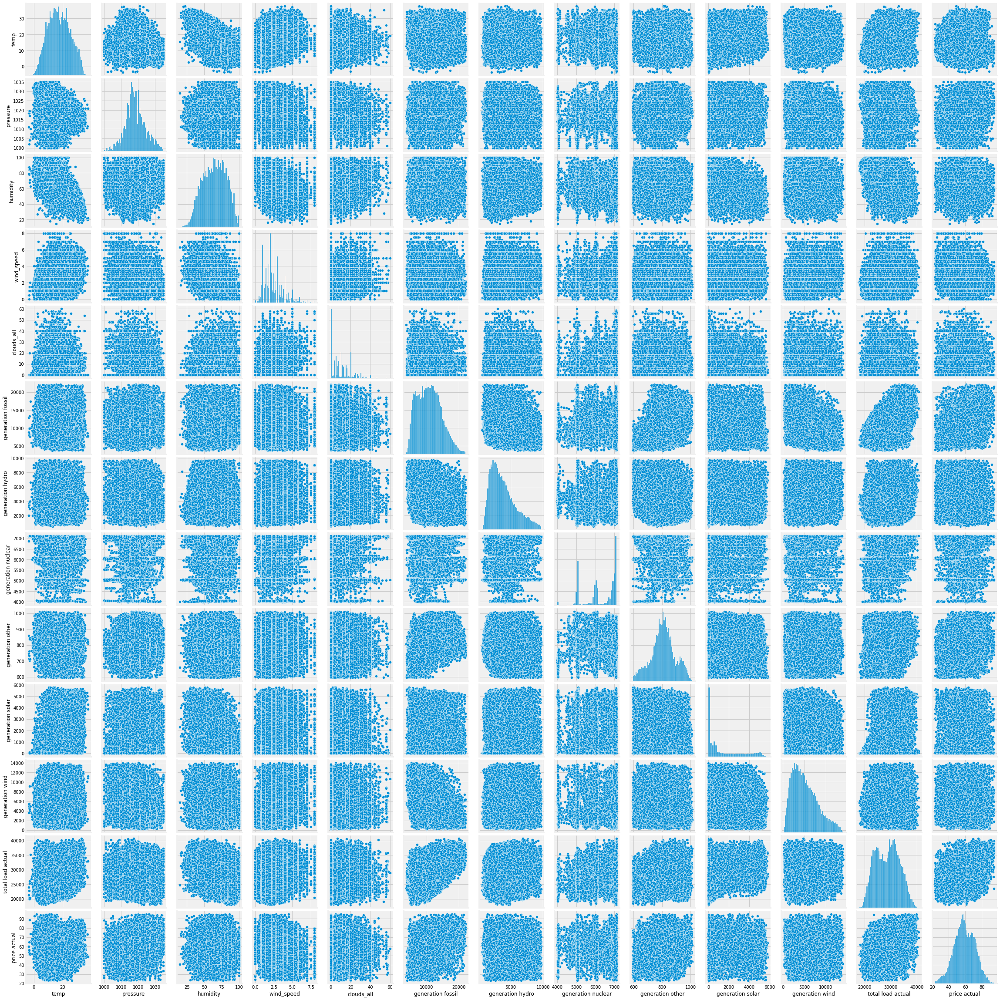

In [147]:
sns.pairplot(df)
plt.savefig(graphics +'pairplot_df'+extension);

In [150]:
df.corr()

,temp,pressure,humidity,wind_speed,clouds_all,generation fossil,generation hydro,generation nuclear,generation other,generation solar,generation wind,total load actual,price actual
temp,1.000000,-0.246196,-0.649658,0.204733,0.003985,0.117551,-0.096104,-0.021635,0.068034,0.440735,-0.117348,0.235759,0.068579
pressure,-0.246196,1.000000,0.180773,-0.236911,-0.282892,0.055854,-0.064134,0.079288,0.069640,-0.013255,-0.092362,-0.045905,0.140982
humidity,-0.649658,0.180773,1.000000,-0.396383,0.042654,-0.069586,-0.036022,-0.017669,-0.004488,-0.560588,-0.063936,-0.394712,-0.036521
wind_speed,0.204733,-0.236911,-0.396383,1.000000,0.231554,-0.057809,0.114721,0.004372,-0.031425,0.217751,0.230300,0.214535,-0.113816
clouds_all,0.003985,-0.282892,0.042654,0.231554,1.000000,-0.002276,0.065579,0.010918,-0.024786,0.034746,0.041866,0.065089,-0.034948
generation fossil,0.117551,0.055854,-0.069586,-0.057809,-0.002276,1.000000,-0.244218,-0.088301,0.350632,0.068666,-0.432761,0.539457,0.482933
generation hydro,-0.096104,-0.064134,-0.036022,0.114721,0.065579,-0.244218,1.000000,-0.062920,-0.209168,0.035312,0.093961,0.281925,-0.033527
generation nuclear,-0.021635,0.079288,-0.017669,0.004372,0.010918,-0.088301,-0.062920,1.000000,0.015057,0.007449,0.064973,0.087129,-0.073725
generation other,0.068034,0.069640,-0.004488,-0.031425,-0.024786,0.350632,-0.209168,0.015057,1.000000,-0.016464,-0.123661,0.126873,0.215769
generation solar,0.440735,-0.013255,-0.560588,0.217751,0.034746,0.068666,0.035312,0.007449,-0.016464,1.000000,-0.164987,0.419278,0.111975


In [151]:
df.corr()['price actual'].sort_values(ascending=False)

price actual          1.000000
generation fossil     0.482933
total load actual     0.416560
generation other      0.215769
pressure              0.140982
generation solar      0.111975
temp                  0.068579
generation hydro     -0.033527
clouds_all           -0.034948
humidity             -0.036521
generation nuclear   -0.073725
wind_speed           -0.113816
generation wind      -0.171035
Name: price actual, dtype: float64

In [152]:
#row number
df.shape

(31601, 13)

**Se ha finalizado el proceso de Exploración de los Datos. 
El conjunto de datos resultantes consta de 31.614 filas y de 13 columnas.**

In [156]:
#columns number
df.columns.shape[0]

13

In [154]:
df.columns

Index(['temp', 'pressure', 'humidity', 'wind_speed', 'clouds_all',
       'generation fossil', 'generation hydro', 'generation nuclear',
       'generation other', 'generation solar', 'generation wind',
       'total load actual', 'price actual'],
      dtype='object')

**La columna de precio será a asignada como ‘target’ para el siguiente paso, el 
Estudio de los modelos de ‘Machine Learning’, donde la columna de precio será asignada como ‘target’.**